# Telco Customer Churn Prediction Project

## Join the Files into one File

#### 1) Read the Three CSV Tables

**Read the paths of our three csv tables **

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
%matplotlib inline
warnings.filterwarnings("ignore")
from azureml.core import Dataset, Workspace

# Connect to your Azure ML workspace
ws = Workspace.from_config()

# Get the dataset (the folder you've uploaded in Data Assets)
dataset = Dataset.File.from_files(path=(ws.datastores['workspaceblobstore'], 'UI/2024-10-17_090040_UTC/dw data/*'))

# Display the file paths in the dataset
file_paths = dataset.to_path()
print(file_paths)

{'infer_column_types': 'False', 'activity': 'to_path'}
{'infer_column_types': 'False', 'activity': 'to_path', 'activityApp': 'FileDataset'}
['/customer_inter.csv', '/customer_trans.csv', '/telco_customer_data.csv']


**Read our CSV files and print the first five rows of each of them**

In [2]:
from IPython.display import display
# Iterate over the file paths to read each CSV file
dfs = []

# Make the static path or the folder path that will be the same in the three files
static_path = "azureml://subscriptions/0146ae78-9468-4285-8cab-97231deb201d/resourcegroups/Final_Project/workspaces/CustomerChurnPrediction/datastores/workspaceblobstore/paths/UI/2024-10-17_090040_UTC/dw data/{}"

for file_path in file_paths:
    if file_path.endswith('.csv'):
        # Read the CSV file directly from the blob storage into a pandas DataFrame
        df = pd.read_csv(static_path.format(file_path))
        dfs.append(df)

# Check the number of dataframes loaded
print(f"Successfully Loaded {len(dfs)} CSV files.")

# Display the first few rows of each DataFrame to verify
print("\ncustomer_inter.csv:")
display(dfs[0].head())
print(dfs[0].shape)

print("\ncustomer_trans.csv:")
display(dfs[1].head())
print(dfs[1].shape)

print("\ntelco_customer_data.csv:")
display(dfs[2].head())
print(dfs[2].shape)

Successfully Loaded 3 CSV files.

customer_inter.csv:


,Customer_ID,Count,Quarter,Satisfaction_Score,Customer_Status,Churn_Label,Churn_Value,Churn_Score,CLTV,Churn_Category,Churn_Reason,inter_ID
0,0002-ORFBO,1,Q3,3,Stayed,No,0.0,65,2205.0,NaN,NaN,4007
1,0003-MKNFE,1,Q3,5,Stayed,No,0.0,66,5414.0,NaN,NaN,4789
2,0004-TLHLJ,1,Q3,1,Churned,Yes,1.0,71,4479.0,Competitor,Competitor had better devices,1902
3,0011-IGKFF,1,Q3,1,Churned,Yes,1.0,91,3714.0,Dissatisfaction,Product dissatisfaction,396
4,0013-EXCHZ,1,Q3,1,Churned,Yes,1.0,68,3464.0,Dissatisfaction,Network reliability,369


(7043, 12)

customer_trans.csv:


,Customer_ID,Count,Quarter,Referred_a_Friend,Number_of_Referrals,Tenure_in_Months,Offer,Phone_Service,Avg_Monthly_Long_Distance_Charges,Multiple_Lines,...,Contract,Paperless_Billing,Payment_Method,Monthly_Charge,Total_Charges,Total_Refunds,Total_Extra_Data_Charges,Total_Long_Distance_Charges,Total_Revenue,trans_ID
0,9281-PKKZE,1,Q3,True,1,46,NaN,False,0.00,False,...,Month-to-Month,True,Bank Withdrawal,43.95,2007.85,0.0,0.0,0.00,2007.85,1
1,3638-VBZTA,1,Q3,False,0,68,NaN,True,11.50,True,...,Two Year,True,Bank Withdrawal,86.50,5882.75,0.0,0.0,782.00,6664.75,2
2,7459-IMVYU,1,Q3,False,0,38,NaN,True,28.00,True,...,Month-to-Month,False,Bank Withdrawal,69.95,2657.55,0.0,90.0,1064.00,3811.55,3
3,8563-OYMQY,1,Q3,False,0,17,Offer D,True,34.98,False,...,Month-to-Month,True,Credit Card,90.95,1612.20,0.0,0.0,594.66,2206.86,4
4,0754-EEBDC,1,Q3,True,1,4,Offer E,True,24.57,False,...,Two Year,False,Mailed Check,19.90,76.65,0.0,0.0,98.28,174.93,5


(7043, 31)

telco_customer_data.csv:


,Customer_ID,Count,Gender,Age,Under_30,Senior_Citizen,Married,Dependents,Number_of_Dependents,Country,State,City,Zip_Code
0,0002-ORFBO,1,Female,37,False,False,True,False,0,United States,California,Frazier Park,93225
1,0003-MKNFE,1,Male,46,False,False,False,False,0,United States,California,Glendale,91206
2,0004-TLHLJ,1,Male,50,False,False,False,False,0,United States,California,Costa Mesa,92627
3,0011-IGKFF,1,Male,78,False,True,True,False,0,Country,California,Martinez,94553
4,0013-EXCHZ,1,Female,75,False,True,True,False,0,Country,California,Camarillo,93010


(7043, 13)


#### 2) Merge the Three Datasets
merge the three datasets by the common column  "Customer_ID" and and remove the duplicate columns

**Merge the Datasets**

In [3]:
# Assigning the common column is 'CustomerID'
common_column = 'Customer_ID'

# Merge the dataframes on the common column
merged_df = dfs[0]
for df in dfs[1:]:
    merged_df = pd.merge(merged_df, df, on=common_column, how='inner',)

# Display the merged DataFrame
print("Merged DataFrame:")
display(merged_df.head())

#Let's inspect the columns of the dataframe if it's has duplicated columns
print("""\n Inspect if Merged DataFrame has duplicated columns: 
{}""".format(merged_df.columns.to_list()))

Merged DataFrame:


,Customer_ID,Count_x,Quarter_x,Satisfaction_Score,Customer_Status,Churn_Label,Churn_Value,Churn_Score,CLTV,Churn_Category,...,Age,Under_30,Senior_Citizen,Married,Dependents,Number_of_Dependents,Country,State,City,Zip_Code
0,0002-ORFBO,1,Q3,3,Stayed,No,0.0,65,2205.0,NaN,...,37,False,False,True,False,0,United States,California,Frazier Park,93225
1,0003-MKNFE,1,Q3,5,Stayed,No,0.0,66,5414.0,NaN,...,46,False,False,False,False,0,United States,California,Glendale,91206
2,0004-TLHLJ,1,Q3,1,Churned,Yes,1.0,71,4479.0,Competitor,...,50,False,False,False,False,0,United States,California,Costa Mesa,92627
3,0011-IGKFF,1,Q3,1,Churned,Yes,1.0,91,3714.0,Dissatisfaction,...,78,False,True,True,False,0,Country,California,Martinez,94553
4,0013-EXCHZ,1,Q3,1,Churned,Yes,1.0,68,3464.0,Dissatisfaction,...,75,False,True,True,False,0,Country,California,Camarillo,93010



 Inspect if Merged DataFrame has duplicated columns: 
['Customer_ID', 'Count_x', 'Quarter_x', 'Satisfaction_Score', 'Customer_Status', 'Churn_Label', 'Churn_Value', 'Churn_Score', 'CLTV', 'Churn_Category', 'Churn_Reason', 'inter_ID', 'Count_y', 'Quarter_y', 'Referred_a_Friend', 'Number_of_Referrals', 'Tenure_in_Months', 'Offer', 'Phone_Service', 'Avg_Monthly_Long_Distance_Charges', 'Multiple_Lines', 'Internet_Service', 'Internet_Type', 'Avg_Monthly_GB_Download', 'Online_Security', 'Online_Backup', 'Device_Protection_Plan', 'Premium_Tech_Support', 'Streaming_TV', 'Streaming_Movies', 'Streaming_Music', 'Unlimited_Data', 'Contract', 'Paperless_Billing', 'Payment_Method', 'Monthly_Charge', 'Total_Charges', 'Total_Refunds', 'Total_Extra_Data_Charges', 'Total_Long_Distance_Charges', 'Total_Revenue', 'trans_ID', 'Count', 'Gender', 'Age', 'Under_30', 'Senior_Citizen', 'Married', 'Dependents', 'Number_of_Dependents', 'Country', 'State', 'City', 'Zip_Code']


**Drop Duplicated Columns**

We noticed that there is three duplicated columns it should be 51 Columns not 54 Columns and we noticed that there is columns like Count_x , Count_y and Count is the same column and we just want "Count" Column then remove the rest and we also noticed that We have Quarter_x and Quarter_y but we don't have "Quarter" column that because it was duplicated in two tables of the three tables we have so we need to change the name of one of them to "Quarter" and remove the other. 

In [4]:
# Check for columns with '_x' or '_y' suffixes (which indicates duplicates)
duplicate_columns = [col for col in merged_df.columns if (col.endswith('_x') or col.endswith('_y'))]

# Drop the duplicate columns
for col in duplicate_columns:
    original_col = col[:-2]  # Get the original column name without '_x' or '_y'
    if original_col in merged_df.columns:
        merged_df = merged_df.drop(col, axis=1)
    
    if original_col not in merged_df.columns:
        if col.endswith("_x"):
            merged_df.rename(columns={col: '{}'.format(original_col)}, inplace=True)
        else:
            merged_df = merged_df.drop(col.endswith("_y"), axis=1)


# Display the resulting DataFrame without duplicates
print("Merged DataFrame without duplicate columns:")
display(merged_df.head())

Merged DataFrame without duplicate columns:


,Customer_ID,Quarter,Satisfaction_Score,Customer_Status,Churn_Label,Churn_Value,Churn_Score,CLTV,Churn_Category,Churn_Reason,...,Age,Under_30,Senior_Citizen,Married,Dependents,Number_of_Dependents,Country,State,City,Zip_Code
0,0002-ORFBO,Q3,3,Stayed,No,0.0,65,2205.0,NaN,NaN,...,37,False,False,True,False,0,United States,California,Frazier Park,93225
1,0003-MKNFE,Q3,5,Stayed,No,0.0,66,5414.0,NaN,NaN,...,46,False,False,False,False,0,United States,California,Glendale,91206
2,0004-TLHLJ,Q3,1,Churned,Yes,1.0,71,4479.0,Competitor,Competitor had better devices,...,50,False,False,False,False,0,United States,California,Costa Mesa,92627
3,0011-IGKFF,Q3,1,Churned,Yes,1.0,91,3714.0,Dissatisfaction,Product dissatisfaction,...,78,False,True,True,False,0,Country,California,Martinez,94553
4,0013-EXCHZ,Q3,1,Churned,Yes,1.0,68,3464.0,Dissatisfaction,Network reliability,...,75,False,True,True,False,0,Country,California,Camarillo,93010


#### 3) save the merged dataframe 

In [5]:
# Define the target path in the local environment for the CSV file
target_path = 'merged_customer_data.csv'

# Save the DataFrame as a CSV in the local environment
merged_df.to_csv(target_path, index=False)

## Analysis and Predictive Models
Telco customer churn: This sample data module tracks a fictional telco company's customer churn based on a variety of possible factors. The churn column indicates whether or not the customer left within the last month. Other columns include gender, dependents, monthly charges, and many with information about the types of services each customer has. Source: IBM. Location: Team content > Samples > Data. The Telco customer churn data module is composed of 5 uploaded files:
1. Telco_customer_churn_demographics.xlsx
2. Telco_customer_churn_location.xlsx
3. Telco_customer_churn_services.xlsx
4. Telco_customer_churn_status.xlsx
##### Demographics:
**CustomerID**: A unique ID that identifies each customer.

**Count**: A value used in reporting/dashboarding to sum up the number of customers in a filtered set.

**Gender**: The customer’s gender: Male, Female

**Age**: The customer’s current age, in years, at the time the fiscal quarter ended.

**Senior Citizen**: Indicates if the customer is 65 or older: Yes, No

**Married**: Indicates if the customer is married: Yes, No

**Dependents**: Indicates if the customer lives with any dependents: Yes, No. Dependents could be children, parents, grandparents, etc.

**Number of Dependents**: Indicates the number of dependents that live with the customer.

 

##### Location
**Country**: The country of the customer’s primary residence.

**State**: The state of the customer’s primary residence.

**City**: The city of the customer’s primary residence.

**Zip Code**: The zip code of the customer’s primary residence.

 

##### Services
**Referred a Friend**: Indicates if the customer has ever referred a friend or family member to this company: Yes, No

**Number of Referrals**: Indicates the number of referrals to date that the customer has made.

**Tenure in Months**: Indicates the total amount of months that the customer has been with the company by the end of the quarter specified above.

**Offer**: Identifies the last marketing offer that the customer accepted, if applicable. Values include None, Offer A, Offer B, Offer C, Offer D, and Offer E.

**Phone Service**: Indicates if the customer subscribes to home phone service with the company: Yes, No

**Avg Monthly Long Distance Charges**: Indicates the customer’s average long distance charges, calculated to the end of the quarter specified above.

**Multiple Lines**: Indicates if the customer subscribes to multiple telephone lines with the company: Yes, No

**Internet Service**: Indicates if the customer subscribes to Internet service with the company: No, DSL, Fiber Optic, Cable.

**Avg Monthly GB Download**: Indicates the customer’s average download volume in gigabytes, calculated to the end of the quarter specified above.

**Online Security**: Indicates if the customer subscribes to an additional online security service provided by the company: Yes, No

**Online Backup**: Indicates if the customer subscribes to an additional online backup service provided by the company: Yes, No

**Device Protection Plan**: Indicates if the customer subscribes to an additional device protection plan for their Internet equipment provided by the company: Yes, No

**Premium Tech Support**: Indicates if the customer subscribes to an additional technical support plan from the company with reduced wait times: Yes, No

**Streaming TV**: Indicates if the customer uses their Internet service to stream television programing from a third party provider: Yes, No. The company does not charge an additional fee for this service.

**Streaming Movies**: Indicates if the customer uses their Internet service to stream movies from a third party provider: Yes, No. The company does not charge an additional fee for this service.

**Streaming Music**: Indicates if the customer uses their Internet service to stream music from a third party provider: Yes, No. The company does not charge an additional fee for this service.

**Unlimited Data**: Indicates if the customer has paid an additional monthly fee to have unlimited data downloads/uploads: Yes, No

**Contract**: Indicates the customer’s current contract type: Month-to-Month, One Year, Two Year.

**Paperless Billing**: Indicates if the customer has chosen paperless billing: Yes, No

**Payment Method**: Indicates how the customer pays their bill: Bank Withdrawal, Credit Card, Mailed Check

**Monthly Charge**: Indicates the customer’s current total monthly charge for all their services from the company.

**Total Charges**: Indicates the customer’s total charges, calculated to the end of the quarter specified above.

**Total Refunds**: Indicates the customer’s total refunds, calculated to the end of the quarter specified above.

**Total Extra Data Charges**: Indicates the customer’s total charges for extra data downloads above those specified in their plan, by the end of the quarter specified above.

**Total Long Distance Charges**: Indicates the customer’s total charges for long distance above those specified in their plan, by the end of the quarter specified above.

 

##### Status
**Quarter**: The fiscal quarter that the data has been derived from (e.g. Q3).

**Satisfaction Score**: A customer’s overall satisfaction rating of the company from 1 (Very Unsatisfied) to 5 (Very Satisfied).

**Satisfaction Score Label**: Indicates the text version of the score (1-5) as a text string.

**Customer Status**: Indicates the status of the customer at the end of the quarter: Churned, Stayed, or Joined

**Churn Label**: Yes = the customer left the company this quarter. No = the customer remained with the company. Directly related to Churn Value.

**Churn Value**: 1 = the customer left the company this quarter. 0 = the customer remained with the company. Directly related to Churn Label.

**Churn Score**: A value from 0-100 that is calculated using the predictive tool IBM SPSS Modeler. The model incorporates multiple factors known to cause churn. The higher the score, the more likely the customer will churn.

**Churn Score Category**: A calculation that assigns a Churn Score to one of the following categories: 0-10, 11-20, 21-30, 31-40, 41-50, 51-60, 61-70, 71-80, 81-90, and 91-100

**CLTV**: Customer Lifetime Value. A predicted CLTV is calculated using corporate formulas and existing data. The higher the value, the more valuable the customer. High value customers should be monitored for churn.

**CLTV Category**: A calculation that assigns a CLTV value to one of the following categories: 2000-2500, 2501-3000, 3001-3500, 3501-4000, 4001-4500, 4501-5000, 5001-5500, 5501-6000, 6001-6500, and 6501-7000.

**Churn Category**: A high-level category for the customer’s reason for churning: Attitude, Competitor, Dissatisfaction, Other, Price. When they leave the company, all customers are asked about their reasons for leaving. Directly related to Churn Reason.

**Churn Reason**: A customer’s specific reason for leaving the company. Directly related to Churn Category.

#### **Read The Dataset**

In [6]:
path = "azureml://subscriptions/0146ae78-9468-4285-8cab-97231deb201d/resourcegroups/Final_Project/workspaces/CustomerChurnPrediction/datastores/workspaceblobstore/paths/UI/2024-10-17_145456_UTC/merged_customer_data.csv"
df = pd.read_csv(path)
display(df)

,Customer_ID,Quarter,Satisfaction_Score,Customer_Status,Churn_Label,Churn_Value,Churn_Score,CLTV,Churn_Category,Churn_Reason,...,Age,Under_30,Senior_Citizen,Married,Dependents,Number_of_Dependents,Country,State,City,Zip_Code
0,0002-ORFBO,Q3,3,Stayed,No,0.0,65,2205.0,NaN,NaN,...,37,False,False,True,False,0,United States,California,Frazier Park,93225
1,0003-MKNFE,Q3,5,Stayed,No,0.0,66,5414.0,NaN,NaN,...,46,False,False,False,False,0,United States,California,Glendale,91206
2,0004-TLHLJ,Q3,1,Churned,Yes,1.0,71,4479.0,Competitor,Competitor had better devices,...,50,False,False,False,False,0,United States,California,Costa Mesa,92627
3,0011-IGKFF,Q3,1,Churned,Yes,1.0,91,3714.0,Dissatisfaction,Product dissatisfaction,...,78,False,True,True,False,0,Country,California,Martinez,94553
4,0013-EXCHZ,Q3,1,Churned,Yes,1.0,68,3464.0,Dissatisfaction,Network reliability,...,75,False,True,True,False,0,Country,California,Camarillo,93010
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,9987-LUTYD,Q3,4,Stayed,No,0.0,59,3161.0,NaN,NaN,...,20,True,False,False,False,0,United States,California,La Mesa,91941
7039,9992-RRAMN,Q3,1,Churned,Yes,1.0,68,5248.0,Dissatisfaction,Product dissatisfaction,...,40,False,False,True,False,0,United States,California,Riverbank,95367
7040,9992-UJOEL,Q3,5,Joined,No,0.0,33,5870.0,NaN,NaN,...,22,True,False,False,False,0,United States,California,Elk,95432
7041,9993-LHIEB,Q3,3,Stayed,No,0.0,59,4792.0,NaN,NaN,...,21,True,False,True,False,0,United States,California,Solana Beach,92075


#### **Data Cleaning**

In [7]:
#Print the shape of the data
print("Data Shape: number of Rows = {0}, number of Columns = {1} \n".format(df.shape[0],df.shape[1]))

#print Information and Type about the data
display(df.info())

Data Shape: number of Rows = 7043, number of Columns = 51 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 51 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Customer_ID                        7043 non-null   object 
 1   Quarter                            7043 non-null   object 
 2   Satisfaction_Score                 7043 non-null   int64  
 3   Customer_Status                    7043 non-null   object 
 4   Churn_Label                        7043 non-null   object 
 5   Churn_Value                        7043 non-null   float64
 6   Churn_Score                        7043 non-null   int64  
 7   CLTV                               7043 non-null   float64
 8   Churn_Category                     1869 non-null   object 
 9   Churn_Reason                       1869 non-null   object 
 10  inter_ID                           7043 non-null   int64  
 

None

##### Data Description Summary
The dataset provides a variety of features related to customer behavior, satisfaction, and financial metrics. Below is a summary of key statistical insights:

Satisfaction Score:

The satisfaction scores range from 1 to 5, with an average score of 3.24. The majority of customers fall within the median score of 3, indicating neutral satisfaction.
Churn Value & Score:

Churn Value is a binary column (0 for no churn, 1 for churn). Approximately 26.5% of customers have churned.
Churn Score has a mean of 58.5, with a broad range (5 to 96), indicating varying levels of churn risk across customers.
Customer Lifetime Value (CLTV):

CLTV values range between 2003 and 6500, with an average of 4400, showcasing substantial variance in customer revenue generation.
Tenure in Months:

Tenure ranges from 1 to 72 months, with a median of 29 months. The distribution indicates a mix of long-term and short-term customers.
Average Monthly Long Distance Charges:

The mean monthly charge is $22.96, with substantial variation (standard deviation of 15.45), indicating different levels of usage.
Average Monthly GB Download:

Internet usage ranges from 0 to 85 GB, with a median of 17 GB, which could reflect a mix of light and heavy users.
Monthly Charges:

Monthly charges range from $18.25 to $118.75, with an average of $64.76. The variation suggests different service plans or usage levels.
Total Charges & Revenue:

Total Charges and Revenue show wide ranges, from $18.80 to $8684.80 and $21.36  to $11979.34 respectively, highlighting that customer revenue contributions vary significantly.
Number of Dependents:

The number of dependents has a mean of 0.47, with many customers having no dependents.

In [8]:
print("Show Statical Descriptopn of numerical columns")
df.describe().T

Show Statical Descriptopn of numerical columns


,count,mean,std,min,25%,50%,75%,max
Satisfaction_Score,7043.0,3.244924,1.201657,1.00,3.000,3.00,4.000,5.00
Churn_Value,7043.0,0.265370,0.441561,0.00,0.000,0.00,1.000,1.00
Churn_Score,7043.0,58.505040,21.170031,5.00,40.000,61.00,75.500,96.00
CLTV,7043.0,4400.295755,1183.057152,2003.00,3469.000,4527.00,5380.500,6500.00
inter_ID,7043.0,3522.000000,2033.283305,1.00,1761.500,3522.00,5282.500,7043.00
Number_of_Referrals,7043.0,1.951867,3.001199,0.00,0.000,0.00,3.000,11.00
Tenure_in_Months,7043.0,32.386767,24.542061,1.00,9.000,29.00,55.000,72.00
Avg_Monthly_Long_Distance_Charges,7043.0,22.958954,15.448113,0.00,9.210,22.89,36.395,49.99
Avg_Monthly_GB_Download,7043.0,20.515405,20.418940,0.00,3.000,17.00,27.000,85.00
Monthly_Charge,7043.0,64.761692,30.090047,18.25,35.500,70.35,89.850,118.75


-  We noticed from the object and numerical description of the dataframe that in numerical data the column count only have the value 1 which the count for every row so we will drop it and trans_Id it's not important it is scaled from 1 to 7043 which the number of rows and the same thing for inter_id and we noticed that we need to normalize some columns and for the object description we see that Churn label and churn value in numerical data are redundant and we need to remove one and we don't need the Customer_ID and the Quarter has the value which is Q3 so not useful in analysis or for the model and we see there is a miss value maybe in  column country because it says there is two values United States that has more frequency and something else and at the same time the state has in the whole column the value "California" and we all know it is in United States so we need to check that and finally we see imbalanced in column like the churn_Label and we will inspect further on data for columns like Referred a friend  and number of referrals and the same for dependents and the number we will see if it's the same or one of them are not important or not

In [9]:
# count and unique of object and bool columns
df.describe(include=['object','bool']).T

,count,unique,top,freq
Customer_ID,7043,7043,0002-ORFBO,1
Quarter,7043,1,Q3,7043
Customer_Status,7043,3,Stayed,4720
Churn_Label,7043,2,No,5174
Churn_Category,1869,5,Competitor,841
Churn_Reason,1869,20,Competitor had better devices,313
Referred_a_Friend,7043,2,False,3821
Offer,3166,5,Offer B,824
Phone_Service,7043,2,True,6361
Multiple_Lines,7043,2,False,4072


In [10]:
#Check if there duplicated rows or not
df.duplicated().sum()

0

##### Drop Unwanted Columns
we will drop the columns that we sure we don't need it 

In [11]:
# Delete The list of unwanted column
deleted_list = ["Customer_ID", "Quarter", "trans_ID", "Count", "inter_ID"]
df.drop(columns=deleted_list, inplace=True)
display(df.head())
print("\n Columns: \n{}".format(df.columns.tolist()))

,Satisfaction_Score,Customer_Status,Churn_Label,Churn_Value,Churn_Score,CLTV,Churn_Category,Churn_Reason,Referred_a_Friend,Number_of_Referrals,...,Age,Under_30,Senior_Citizen,Married,Dependents,Number_of_Dependents,Country,State,City,Zip_Code
0,3,Stayed,No,0.0,65,2205.0,NaN,NaN,True,2,...,37,False,False,True,False,0,United States,California,Frazier Park,93225
1,5,Stayed,No,0.0,66,5414.0,NaN,NaN,False,0,...,46,False,False,False,False,0,United States,California,Glendale,91206
2,1,Churned,Yes,1.0,71,4479.0,Competitor,Competitor had better devices,False,0,...,50,False,False,False,False,0,United States,California,Costa Mesa,92627
3,1,Churned,Yes,1.0,91,3714.0,Dissatisfaction,Product dissatisfaction,True,1,...,78,False,True,True,False,0,Country,California,Martinez,94553
4,1,Churned,Yes,1.0,68,3464.0,Dissatisfaction,Network reliability,True,3,...,75,False,True,True,False,0,Country,California,Camarillo,93010



 Columns: 
['Satisfaction_Score', 'Customer_Status', 'Churn_Label', 'Churn_Value', 'Churn_Score', 'CLTV', 'Churn_Category', 'Churn_Reason', 'Referred_a_Friend', 'Number_of_Referrals', 'Tenure_in_Months', 'Offer', 'Phone_Service', 'Avg_Monthly_Long_Distance_Charges', 'Multiple_Lines', 'Internet_Service', 'Internet_Type', 'Avg_Monthly_GB_Download', 'Online_Security', 'Online_Backup', 'Device_Protection_Plan', 'Premium_Tech_Support', 'Streaming_TV', 'Streaming_Movies', 'Streaming_Music', 'Unlimited_Data', 'Contract', 'Paperless_Billing', 'Payment_Method', 'Monthly_Charge', 'Total_Charges', 'Total_Refunds', 'Total_Extra_Data_Charges', 'Total_Long_Distance_Charges', 'Total_Revenue', 'Gender', 'Age', 'Under_30', 'Senior_Citizen', 'Married', 'Dependents', 'Number_of_Dependents', 'Country', 'State', 'City', 'Zip_Code']


##### Inspect the Columns
we will search and inspect the columns that we don't sure that if need it or not

In [12]:
display(df[["Country","State"]].head())
print("\n Group by count to see the values  between to columns:")
Value_Counts = df.groupby(["Country","State"]).size().reset_index(name="count")
display(Value_Counts)


,Country,State
0,United States,California
1,United States,California
2,United States,California
3,Country,California
4,Country,California



 Group by count to see the values  between to columns:


,Country,State,count
0,Country,California,414
1,United States,California,6629


ok now we know that it is just two columns that has the same values so we will drop them but we continue the inspecting if we found more columns

In [13]:
display(df[["Churn_Label","Churn_Value"]].head())

print("\n Group by count to see the values  between two columns:")
# See if there a difference between the Churn_Label and the Churn_Value
Value_Counts = df.groupby(["Churn_Label","Churn_Value"]).size().reset_index(name="count")
display(Value_Counts)

print("\n")

display(df[["Churn_Label","Customer_Status"]].head())
print("\n Group by count to see the values  between two columns:")

# See if there a difference between the Churn_Label and the Customer_Status
Value_Counts = df.groupby(["Churn_Label","Customer_Status"]).size().reset_index(name="count")
display(Value_Counts)

,Churn_Label,Churn_Value
0,No,0.0
1,No,0.0
2,Yes,1.0
3,Yes,1.0
4,Yes,1.0



 Group by count to see the values  between two columns:


,Churn_Label,Churn_Value,count
0,No,0.0,5174
1,Yes,1.0,1869


,Churn_Label,Customer_Status
0,No,Stayed
1,No,Stayed
2,Yes,Churned
3,Yes,Churned
4,Yes,Churned



 Group by count to see the values  between two columns:


,Churn_Label,Customer_Status,count
0,No,Joined,454
1,No,Stayed,4720
2,Yes,Churned,1869


now we found that we have redundant columns like Churn_Label and Churn_Value and Customer_Status and we need just one column of them and i will be Churn_Label and drop the others

In [14]:
display(df[["Dependents","Number_of_Dependents"]].head())

print("\n Group by count to see the values  between two columns:")
# See if there a difference between the Dependents and the number of Dependents
Value_Counts = df.groupby(["Dependents", "Number_of_Dependents"]).size().reset_index(name="count")
display(Value_Counts)

print("\n")

display(df[["Referred_a_Friend","Number_of_Referrals"]].head())
print("\n Group by count to see the values  between two columns:")

# See if there a difference between the Referred_a_Friend and the number of Referrals
Value_Counts = df.groupby(["Referred_a_Friend", "Number_of_Referrals"]).size().reset_index(name="count")
display(Value_Counts)

,Dependents,Number_of_Dependents
0,False,0
1,False,0
2,False,0
3,False,0
4,False,0


We Found two redundant columns that one is categorical and the other is numerical so we will drop one of them and it will be the categorical because the numerical has more information

#### Drop Redundant and univalue Columns 

In [ ]:
# Delete The list of Redundant column
deleted_list = ["Country", "State", "Churn_Value", "Customer_Status", "Dependents", "Referred_a_Friend"]
df.drop(columns=deleted_list, inplace=True)
display(df.head())
print("\n Columns: \n{}".format(df.columns.tolist()))

#### Check on Null Values

In [ ]:
# Make a Table of number of nulls and its percentage
missing_number = df.isnull().sum().sort_values(ascending=False)
missing_percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
display(missing_values)

Let's Visualize it

In [ ]:
import plotly.express as px
df_null = df.isnull().astype(int)


fig = px.imshow(df_null, 
                labels=dict(x="", y="Index", color="Missing"),
                color_continuous_scale='Blues', 
                title="Missing Values Heatmap")

fig.show()

**OK, We noticed that the two columns that have high percentage of nulls are Churn_Category and Churn_Reason  and it's obvious that they have a relation of the churn_label so before we decide to delete null or fill null values or drop the whole column  we should see the relation between the three Columns**

In [ ]:
display(df[["Churn_Category","Churn_Reason", "Churn_Label"]].head())

print("\n Group by count to see the values  between the columns:")
# See if there a difference between the Category and the reason with the labels
Value_Counts = df.groupby(["Churn_Category","Churn_Reason", "Churn_Label"]).size().reset_index(name="count")
display(Value_Counts)
print("\n it shows that all values for label was yes so when it be No there is no shared value with category or the reason\n")
# Filter rows where Churn_Label is "No"
no_churn_df = df[df["Churn_Label"] == "No"]

# Count the null values in Churn_Reason and Churn_Category
churn_reason_null = no_churn_df["Churn_Reason"].isnull().sum()
churn_category_null = no_churn_df["Churn_Category"].isnull().sum()

# Create a summary table
null_summary = pd.DataFrame({
    "Churn_Label": ["No"],
    "Churn_Reason_Null_Count": [churn_reason_null],
    "Churn_Category_Null_Count": [churn_category_null]
})

# Display the table
display(null_summary)

From this we can say that there is no reason for a churn and no category for this churn if the customer is not churned!! so we can impute or fill the null values for these two columns with any string that indicate that the customer is not churned and that's it

In [ ]:
df[['Churn_Category', 'Churn_Reason']] = df[['Churn_Category', 'Churn_Reason']].fillna('Not Churned')
display(df[["Churn_Category"]].value_counts().reset_index(name='Count'))
display(df[["Churn_Reason"]].value_counts().reset_index(name='Count'))

Now after we fill the nulls let's check if these two columns still have nulls or not

In [ ]:
# Make a Table of number of nulls and its percentage
missing_number = df.isnull().sum().sort_values(ascending=False)
missing_percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
display(missing_values)

Let's handle the internet Type first  its 21% of the columns is null  so let's see what is the values of the column and which one is the most frequency and we have two choices here first one to impute or fill the null values with Mode which is Fiber-Optic or fill it with string like "Not Subscriber" and it depends on the internet service column if all the null values of internet type  equal null when the internet is False so it make sense and we will fill the null with string "Not Subscriber" because how the customer have a internet type if he don't have a internet service but if we found that some of null values  of internet type  when internet service are True so it not make any sense to fill with "Not Subscriber" and we may fill it with the mode

In [ ]:
display(df[["Internet_Type"]].value_counts().reset_index(name='Count'))
# Show the relation between internet type and the target Service label
print("\n this with the values of internet type")

Value_Counts = df.groupby(["Internet_Service", "Internet_Type"]).size().reset_index(name="count")
display(Value_Counts)
print("\n this with null values of internet type and the Service label:")

# Filter rows where Internet_Service is "False"
no_service_df = df[df["Internet_Service"] == False]

# Filter rows where Internet_Service is "True"
yes_Service_df = df[df["Internet_Service"] == True]

# Count the null values in Internet_Type
Service_noInternet_null = no_service_df["Internet_Type"].isnull().sum()
Service_yesInternet_null = yes_Service_df["Internet_Type"].isnull().sum()

# Create a summary table
no_null_summary = pd.DataFrame({
    "Internet_Service": ["No"],
    "Internet_Type_Null_Count": [Service_noInternet_null]
    
})

yes_null_summary = pd.DataFrame({
    "Internet_Service": ["Yes"],
    "Internet_Type_Null_Count": [Service_yesInternet_null]
})

# Display the table
display(no_null_summary)
print("\n")
display(yes_null_summary)

Given the counts of different `Internet_Type` categories and the number of missing values for each `Internet_Service`, it is recommended to fill the missing values in the `Internet_Type` column with String. 

- The string for `Internet_Type` is **`Not Subscriber`**, which is describe these nulls what they are and good for analysis.
- Filling missing values with **Not Subscriber** helps retain all records and Make sense of  internet type in the dataset.
- This approach ensures that the analysis will consider a representative sample of customers while minimizing potential bias.

In [ ]:
# Fill missing values in Internet_Type with the string "Not Subscriber"
df['Internet_Type'].fillna("Not Subscriber", inplace=True)
display(df[["Internet_Type"]].value_counts().reset_index(name='Count'))

The "Offer" column contains over 55% null values. Given this high percentage, we face two primary challenges:

1. **Row Deletion**: Deleting rows with null values would result in a significant loss of data, which is not advisable.
  
2. **Imputation with Most Frequent Value**: Filling null values with the most frequently occurring value could introduce bias, as this may not accurately represent the true distribution of offers.

**Proposed Solutions for Imputation**

To address the null values in the "Offer" column, we can consider the following options:

- **Impute with "No Offer"**: This option assumes that a significant number of customers do not receive any offers. It accurately reflects the possibility that the absence of an offer is a legitimate state for many customers.

- **Impute with "None", "Unknown", or "Missing"**: These options indicate uncertainty regarding whether an offer was available. They suggest that while some customers may have had offers (a, b, or c), others may not have received any offers at all.

**Next Steps**

Before deciding on the imputation strategy, we will inspect the correlation with the target column to understand how these options may impact our analysis. This inspection will help us determine which string value best fits our data context.

In [ ]:
display(df[["Offer"]].value_counts().reset_index(name='Count'))
# Show the relation between Offer and the target churn label
print("\n this with the values of Offer")

Value_Counts = df.groupby(["Churn_Label", "Offer"]).size().reset_index(name="count")
display(Value_Counts)
print("\n this with null values of Offer and the churn label:")

# Filter rows where Churn_Label is "No"
no_churn_df = df[df["Churn_Label"] == "No"]

# Filter rows where Churn_Label is "Yes"
yes_churn_df = df[df["Churn_Label"] == "Yes"]

# Count the null values in Offer
churn_no_Offer_null = no_churn_df["Offer"].isnull().sum()
churn_yes_Offer_null = yes_churn_df["Offer"].isnull().sum()

# Create a summary table
no_null_summary = pd.DataFrame({
    "Churn_Label": ["No"],
    "Offer_Null_Count": [churn_no_Offer_null]
    
})

yes_null_summary = pd.DataFrame({
    "Churn_Label": ["Yes"],
    "Offer_Null_Count": [churn_yes_Offer_null]
})

# Display the table
display(no_null_summary)
print("\n")
display(yes_null_summary)

The `Offer` column contains over **55%** null values, posing significant challenges for data integrity. Given the counts of different offers and the number of missing values associated with each `Churn_Label`, we propose two options for handling the null values:

1. **Impute with "No Offer"**: This option assumes that a significant number of customers did not receive any offers. It accurately reflects the possibility that the absence of an offer is a legitimate state for many customers, and it provides clarity in our analysis.

2. **Impute with "Unknown"**: While this option suggests uncertainty regarding offers, it does not convey a clear meaning about whether offers were available, which may introduce ambiguity into our analysis.

**Recommendation**
After inspecting the correlation with the target column, it is recommended to fill the missing values in the `Offer` column with **"No Offer"** to ensure we maintain data integrity and provide a meaningful representation of customer behavior.


In [ ]:
# Fill missing values in Offer with "No Offer"
df['Offer'].fillna('No Offer', inplace=True)
display(df[["Offer"]].value_counts().reset_index(name='Count'))

### Check the null values
Now after we fill the nulls let's check if the dataframe has nulls or not

In [ ]:
# Make a Table of number of nulls and its percentage
missing_number = df.isnull().sum().sort_values(ascending=False)
missing_percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
display(missing_values)

In [ ]:
import plotly.express as px
df_null = df.isnull().astype(int)


fig = px.imshow(df_null, 
                labels=dict(x="", y="Index", color="Missing"),
                color_continuous_scale='Blues', 
                title="Missing Values Heatmap")

fig.show()

#### **Exploratory Data Analysis**
Now we will Show insights with Visualization

In [ ]:
# Define a custom color palette with shades of blue
blue_shades = ['#4169E1', '#87CEFA']

# Create the pie chart with custom blue shades
fig = px.pie(df, names='Churn_Label', title='Percentage of Churn', 
             color_discrete_sequence=blue_shades)

fig.show()


In [ ]:
# Initialize Plotly and Bokeh for rendering visualizations in a Jupyter notebook

# The first line initializes Plotly's offline mode so that plots can be rendered within the notebook.
import plotly.offline as pyo
pyo.init_notebook_mode(connected=True)

# The second part initializes Bokeh to output visualizations directly in the notebook as well.
from bokeh.plotting import output_notebook
output_notebook()

Make a Sample Report has Visualizations of all Columns with Alerts for each Column

In [29]:
from ydata_profiling import ProfileReport
# Generate the profiling report
profile = ProfileReport(df, title="Sample Profiling Report", explorative=True)

# To display the report in a Jupyter Notebook
profile.to_notebook_iframe()

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [30]:
# save the report to an HTML file
profile.to_file("sample_profiling_report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [31]:
fig = px.histogram(df, x="Gender", color="Churn_Label",width=600, height=600, color_discrete_sequence=['#000080',  '#ADD8E6'])
fig.show()

There is not much difference between gender on the churn rate.

In [32]:
import plotly.express as px
import plotly.subplots as sp

# Creating a subplot with three stacked bar charts
fig = sp.make_subplots(rows=1, cols=3, subplot_titles=("Churn vs Phone Service", "Churn vs Internet Service", "Churn vs Multiple Lines"))

# First subplot: Churn by Phone Service
phone_service_fig = px.histogram(
    df, 
    x='Phone_Service', 
    color='Churn_Label',
    color_discrete_sequence=['#000080', '#ADD8E6'], 
    barmode='relative',  # For stacked bar chart
    text_auto=True
)

# Add traces for Phone Service
for trace in phone_service_fig.data:
    trace.showlegend = False  # Hide legend for all traces
    fig.add_trace(trace, row=1, col=1)

# Set legend for the first plot
fig.add_trace(phone_service_fig.data[0].update(showlegend=True), row=1, col=1)

# Second subplot: Churn by Internet Service
internet_service_fig = px.histogram(
    df, 
    x='Internet_Service', 
    color='Churn_Label',
    color_discrete_sequence=['#000080', '#ADD8E6'], 
    barmode='relative',  # For stacked bar chart
    text_auto=True
)

# Add traces for Internet Service
for trace in internet_service_fig.data:
    trace.showlegend = False  # Hide legend for all traces
    fig.add_trace(trace, row=1, col=2)

# Set legend for the first plot
fig.add_trace(internet_service_fig.data[1].update(showlegend=True), row=1, col=2)

# Third subplot: Churn by Multiple Lines
multiple_lines_fig = px.histogram(
    df, 
    x='Multiple_Lines', 
    color='Churn_Label', 
    color_discrete_sequence=['#000080', '#ADD8E6'],
    barmode='relative',  # For stacked bar chart
    text_auto=True
)

# Add traces for Multiple Lines
for trace in multiple_lines_fig.data:
    trace.showlegend = False  # Hide legend for all traces
    fig.add_trace(trace, row=1, col=3)

# Customize layout and aesthetics
fig.update_layout(
    title_text="Churn Distribution by Phone and Internet Service and Multiple Lines",
    height=600, 
    width=1000,
    bargap=0.2,
    plot_bgcolor='white',
    hoverlabel=dict(
        bgcolor="white",
        font_size=14
    ),
)

# Show the figure
fig.show()


This visualization compares the percentage of churn (Yes/No) across three service categories: Phone Service, Internet Service, and Multiple Lines. Each stacked bar chart reveals the distribution of churn (blue for non-churn, light blue for churn) within each category, providing insight into customer retention and churn trends based on the services they use.

Phone Service: The churn rate among customers with and without phone service is visualized. A significant portion of churn occurs among customers without phone service.
Internet Service: The churn rate is compared between customers with different types of internet services. Higher churn is noticeable in certain categories, indicating that internet service may influence customer decisions.
Multiple Lines: Customers with or without multiple phone lines show varying churn rates, with certain patterns of multiple line usage associated with higher retention or churn.
By comparing the heights of the light blue and dark blue sections within each column, we can observe how service type influences churn behavior. This enables us to target specific customer segments for retention efforts.

In [33]:
import plotly.graph_objects as go

# Define specific blue color codes
blue_colors = ['#000080','#0033cc','#4169E1','#66b3ff',  '#87CEFA']  # Custom blue color palette

# Create a figure
fig = go.Figure()

# Unique satisfaction scores sorted in ascending order
satisfaction_scores = sorted(df['Satisfaction_Score'].unique())  # Sort scores to ensure the legend is in ascending order

# Add a trace for each satisfaction score
for i, score in enumerate(satisfaction_scores):
    filtered_data = df[df['Satisfaction_Score'] == score]  # Filter data for each satisfaction score
    
    # Group by Internet Type to get counts
    grouped_data = filtered_data.groupby('Internet_Type').size().reset_index(name='Count')
    
    # Calculate total count of each Internet Type in the full dataset (for percentage calculation)
    total_counts_by_type = df.groupby('Internet_Type').size()

    # Calculate percentage for each Internet Type
    grouped_data['Percentage'] = (grouped_data['Count'] / grouped_data['Internet_Type'].map(total_counts_by_type)) * 100

    # Add trace for this satisfaction score
    trace = go.Bar(
        x=grouped_data['Internet_Type'],
        y=grouped_data['Count'],
        name=str(score),  # Set the name for the legend
        marker_color=blue_colors[i % len(blue_colors)],  # Cycle through the color list
        opacity=0.75,  # Set the opacity for better visualization
        hovertemplate=(
            f"Satisfaction Level: {score}<br>" +
            "Internet Type: %{x}<br>" +  # Show Internet Type on hover
            "Count: %{y}<br>" +
            "Percentage: %{customdata:.2f}%<extra></extra>"  # Show percentage
        ),
        customdata=grouped_data['Percentage'],  # Pass percentage to hovertemplate
    )
    fig.add_trace(trace)

# Customize layout and aesthetics
fig.update_layout(
    title_text="Satisfaction Score vs Internet Type",
    height=600, 
    width=1000,
    barmode='group',  # Group bars
    bargap=0.2,
    plot_bgcolor='white',
    hoverlabel=dict(
        bgcolor="white",
        font_size=14
    ),
    xaxis_title='Internet Type',
    yaxis_title='Count',
    legend_title='Satisfaction Score'
)

# Show the figure
fig.show()


The chart displays the relationship between Satisfaction Score and Internet Type. The bars are grouped by satisfaction levels (1 to 5), and for each internet type, the number of customers and their percentage contribution to that type are shown.

Key insights:

Higher Satisfaction: Certain internet types have a higher percentage of satisfied customers (scores 4 and 5), indicating better service or product fit.
Lower Satisfaction: Lower satisfaction scores (1 and 2) are more prominent in specific internet types, which may suggest dissatisfaction with the service quality or experience.
Clear Trends: The grouped bar format provides a clear view of satisfaction trends across different internet types, helping to target areas for improvement.

In [34]:
import plotly.express as px

# Create the stacked histogram
fig = px.histogram(
    df, 
    x='Contract',  # Contract type on the x-axis
    color='Churn_Label',  # Color/hue by Churn (Yes/No)
    color_discrete_sequence=['#000080',  '#ADD8E6'],
    barmode='relative',  # Stacked bar chart
    text_auto=True  # Automatically display counts on bars
)

# Customize layout
fig.update_layout(
    title_text="Contract Type vs Churn",
    xaxis_title='Contract Type',
    yaxis_title='Customer Count',
    bargap=0.2,
    plot_bgcolor='white',
    hoverlabel=dict(
        bgcolor="white",
        font_size=14
    ),
    legend_title='Churn Label'
)

# Show the figure
fig.show()


This visualization shows the distribution of Contract Types and their relationship with Churn. Each contract type is represented by a single column, with stacked sections indicating the proportion of customers who churned versus those who did not churn.
and we notice that the biggest percentage of churned customer the ones that have a "Month-to-Month" Contract Type

In [35]:
# Filter for churned customers and reset index
df_churn = df[df['Churn_Label'] == 'Yes'].reset_index(drop=True)

# Group by Churn_Reason and Satisfaction_Score, count the occurrences of each
churn_reason = df_churn[~df_churn['Churn_Reason'].isin(["Don't know"])].groupby(['Churn_Reason', 'Satisfaction_Score'], as_index=False).size()

# Rename the count column and reset the index
churn_reason = churn_reason.rename(columns={'size': 'Count'})

# Add a row for "Competitor had better devices" with Satisfaction_Score 3 and count 0
new_row = pd.DataFrame({'Churn_Reason': 'Competitor had better devices', 'Satisfaction_Score': 3, 'Count': 0}, index=[0])
churn_reason = pd.concat([churn_reason, new_row], ignore_index=True)

# Add a column for total churn reasons
churn_reason['total churn reason'] = churn_reason['Churn_Reason'].map(df_churn['Churn_Reason'].value_counts().to_dict())

# Sort the values based on total churn reason and Satisfaction_Score
churn_reason = churn_reason.sort_values(by=['total churn reason', 'Satisfaction_Score'], ascending=[False, True])

# Convert Satisfaction_Score to string for color distinction in the plot
churn_reason['Satisfaction_Score'] = churn_reason['Satisfaction_Score'].astype(str)

# Keep only the top 6 most frequent churn reasons
top_churn_reasons = pd.Series(churn_reason['total churn reason'].unique()).head(6).to_list()
churn_reason = churn_reason[churn_reason['total churn reason'].isin(top_churn_reasons)]

# Plot the bar chart
fig = px.bar(churn_reason, y="Churn_Reason", x="Count", color="Satisfaction_Score", 
             color_discrete_sequence=['#000080', '#4169E1', '#87CEEB', '#ADD8E6'])

# Customize the layout
fig.update_layout(
    autosize=False,
    width=900,
    height=500,
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0,
        pad=0
    ),
    plot_bgcolor='white',
    showlegend=True,
    yaxis={'categoryorder': 'total ascending'},
    legend=dict(
        yanchor="top",
        y=0.35,
        xanchor="left",
        x=0.5
    )
)

# Display the plot
fig.show()


The chart illustrates the relationship between different churn reasons and their associated satisfaction scores. For each churn reason, the count of customers who churned is displayed, categorized by their satisfaction score. The color of each bar represents the satisfaction score of the customers, with darker shades of blue indicating lower satisfaction scores and lighter shades corresponding to higher satisfaction scores. The chart highlights the top six most frequent churn reasons, allowing us to observe patterns in customer satisfaction among the primary reasons for churn.

In [36]:
# Create a new dataframe with only the columns that needed
df_map = df[['Zip_Code', 'City']].drop_duplicates()

# Count the number of churns per Zip_Code
df_churn_count = df[df['Churn_Label'] == 'Yes'].groupby('Zip_Code').size().reset_index(name='Churn')

# Merge churn counts into the new dataframe
df_map = pd.merge(df_map, df_churn_count, on='Zip_Code', how='left')

df_map['Churn'] = df_map['Churn'].fillna(0)
print("df grouped by zip code:")
display(df_map)
# df_map_count =
# Group by City and sum the churn counts
df_city_churn = df_map.groupby('City', as_index=False)['Churn'].sum()

# Rename the column for clarity
df_city_churn = df_city_churn.rename(columns={'Churn': 'Total Churn'})

# Sort by total churn in descending order (optional)
df_city_churn = df_city_churn.sort_values(by='Total Churn', ascending=False).reset_index(drop=True).head(10)
#convert the column Total Churn from float to int
df_city_churn["Total Churn"] =df_city_churn["Total Churn"].astype("int64") 
# Display the resulting dataframe
print("\n Top 10 Cities that has Churned Customers(df grouped by city):")
display(df_city_churn)

df grouped by zip code:


,Zip_Code,City,Churn
0,93225,Frazier Park,0.0
1,91206,Glendale,3.0
2,92627,Costa Mesa,2.0
3,94553,Martinez,2.0
4,93010,Camarillo,3.0
...,...,...,...
1621,93908,Salinas,1.0
1622,96150,South Lake Tahoe,2.0
1623,91934,Jacumba,0.0
1624,93013,Carpinteria,1.0



 Top 10 Cities that has Churned Customers(df grouped by city):


,City,Total Churn
0,San Diego,185
1,Los Angeles,78
2,San Francisco,31
3,San Jose,29
4,Sacramento,26
5,Fallbrook,26
6,Temecula,22
7,Escondido,16
8,Long Beach,15
9,Fresno,13


We grouped the churned customers by city to see which cities had the highest churn counts. The results display the top 10 cities, sorted by the number of churned customers.

We want to Visualize a map to illustrate the churned customers on the cities but we don't have the latitude and longitude so it is difficult to visualize it without these features but we have the zip Code and the zip code are static for real cities so we can search and get the longitude and latitude for these locations from internet and merge them with our df_map_table and visualize the map

In [37]:
#Load Location data
path = "azureml://subscriptions/0146ae78-9468-4285-8cab-97231deb201d/resourcegroups/Final_Project/workspaces/CustomerChurnPrediction/datastores/workspaceblobstore/paths/UI/2024-10-19_083906_UTC/Telco_customer_churn_location.csv"
df_location = pd.read_csv(path)
print("\n df_location:")
display(df_location.head())

df_location = df_location.rename(columns={'Zip Code': 'Zip_Code'})

# Ensure df_location has unique Zip_Code values by dropping duplicates
df_location = df_location.drop_duplicates(subset=['Zip_Code'])
print("\n The merged dataframe(df_final_map):")
#Merge the two dataframes
df_final_map = pd.merge(df_map, df_location[['Zip_Code', 'Latitude', 'Longitude']], on='Zip_Code', how='inner')

# Check the merged dataframe
display(df_final_map)


 df_location:


,Customer ID,Count,Country,State,City,Zip Code,Lat Long,Latitude,Longitude
0,8779-QRDMV,1,United States,California,Los Angeles,90022,"34.02381, -118.156582",34.023810,-118.156582
1,7495-OOKFY,1,United States,California,Los Angeles,90063,"34.044271, -118.185237",34.044271,-118.185237
2,1658-BYGOY,1,United States,California,Los Angeles,90065,"34.108833, -118.229715",34.108833,-118.229715
3,4598-XLKNJ,1,United States,California,Inglewood,90303,"33.936291, -118.332639",33.936291,-118.332639
4,4846-WHAFZ,1,United States,California,Whittier,90602,"33.972119, -118.020188",33.972119,-118.020188



 The merged dataframe(df_final_map):


,Zip_Code,City,Churn,Latitude,Longitude
0,93225,Frazier Park,0.0,34.827662,-118.999073
1,91206,Glendale,3.0,34.162515,-118.203869
2,92627,Costa Mesa,2.0,33.645672,-117.922613
3,94553,Martinez,2.0,38.014457,-122.115432
4,93010,Camarillo,3.0,34.227846,-119.079903
...,...,...,...,...,...
1621,93908,Salinas,1.0,36.624338,-121.615669
1622,96150,South Lake Tahoe,2.0,38.911577,-120.106169
1623,91934,Jacumba,0.0,32.649787,-116.223700
1624,93013,Carpinteria,1.0,34.441398,-119.513163


In [38]:
# Add hover data to include City and Churn count in the tooltip
fig = px.density_mapbox(
    df_final_map, 
    lat='Latitude', 
    lon='Longitude', 
    z='Churn',
    radius=8, 
    zoom=4.4,
    color_continuous_scale='rainbow',
    mapbox_style='open-street-map',  # Other options: 'white-bg', 'carto-darkmatter', 'carto-positron'
    hover_name='City',  # This will show the City name on hover
    hover_data={'Churn': True}  # This will display the churn count on hover
)

# Customize layout
fig.update_layout(
    autosize=False,
    width=600,  # You can adjust the size
    height=600, 
    margin=dict(l=0, r=0, b=0, t=0, pad=0),
    plot_bgcolor='white',
    hoverlabel=dict(
        bgcolor="white",  # Background color of hover box
        font_size=16,     # Font size for hover text
        font_family="Rockwell"  # Font family for hover text
    )
)

# Show the map
fig.show()


this density map highlighting churn patterns by geographic location. The color intensity on the map reflects the churn rate, with cities showing higher churn rates indicated by more vibrant colors. The map also includes hover functionality to display specific churn details for each city, offering a clear visual representation of churn distribution across regions.

In [39]:
import plotly.express as px

# Create the stacked histogram
fig = px.histogram(
    df, 
    x='Offer',  # Offer type on the x-axis
    color='Churn_Label',  # Color/hue by Churn (Yes/No)
    color_discrete_sequence=['#000080',  '#ADD8E6'],
    barmode='relative',  # Stacked bar chart
    text_auto=True  # Automatically display counts on bars
)

# Customize layout
fig.update_layout(
    title_text="Offer type vs Churn",
    xaxis_title='Offer type',
    yaxis_title='Customer Count',
    bargap=0.2,
    plot_bgcolor='white',
    hoverlabel=dict(
        bgcolor="white",
        font_size=14
    ),
    legend_title='Churn Label'
)

# Show the figure
fig.show()


In the visualization, we observe that as we move from Offer A to the "Not Subscriber" category, the percentage of churned customers increases. This trend suggests a growing likelihood of churn among customers who received offers further along the spectrum, culminating in the "Not Subscriber" group. The stacked histogram effectively highlights this relationship, allowing for an intuitive comparison of churn rates across different offer types. This insight could inform strategies to enhance customer retention, particularly for offers that show higher churn rates.

Now Visualize all numerical feature with histograms to make sure they all normally distributed and to check their skewness to decide if we need to log transformation or normalize our data

In [40]:
numerical_cols = df.select_dtypes(include=[np.number]).columns.to_list()
#display the list of numerical Columns
print(numerical_cols,"Length of the list:{}".format(len(numerical_cols)))
#we don't need Zip_Code anymore after the destiny map visualization so we will remove it from the list right now and drop it from the data frame later
numerical_cols.remove("Zip_Code")
print("\nCheck the Length of the list after removing Zip_Code:{}".format(len(numerical_cols)))


import plotly.graph_objs as go
from plotly.subplots import make_subplots
import numpy as np
from scipy.stats import gaussian_kde

# Create subplots - 4 rows, 4 columns
fig = make_subplots(
    rows=4, cols=4, 
    subplot_titles=numerical_cols  # Titles of the subplots are the column names
)

# Define the shades of blue to use
colors = ['#B0E0E6', '#87CEFA', '#4682B4', '#5F9EA0', '#1E90FF', '#00BFFF', '#4169E1', 
          '#6495ED', '#6A5ACD', '#483D8B', '#7B68EE', '#191970', '#000080', '#00008B', '#0000CD']

# Plot each numerical column in a subplot
for i, col in enumerate(numerical_cols):
    row = i // 4 + 1  # Determine the row index (1-based)
    col_idx = i % 4 + 1  # Determine the column index (1-based)
    
    # Extract data for the column, dropping NaN values
    data = df[col].dropna()

    # Add the histogram (normalized)
    fig.add_trace(
        go.Histogram(
            x=data, 
            name=col, 
            marker_color=colors[i], 
            histnorm='probability density',  # Normalize histogram to probability density
            nbinsx=50  # Set number of bins
        ),
        row=row, col=col_idx
    )
    
    # Compute KDE using Gaussian kernel
    kde = gaussian_kde(data)
    x_values = np.linspace(data.min(), data.max(), 500)
    kde_values = kde(x_values)

    # Add the KDE curve (no scaling, already in probability density)
    fig.add_trace(
        go.Scatter(
            x=x_values, 
            y=kde_values,  # Use the unscaled KDE values directly
            mode='lines',
            name=f"KDE_{col}",
            line=dict(color='red', width=2),  # Set the KDE line to red for visibility
        ),
        row=row, col=col_idx
    )

# Update layout
fig.update_layout(
    title_text="Histograms with KDE for Numerical Columns",
    height=1100,  # Adjust for better visibility
    width=1500,
    showlegend=False,  # Hide legend for clarity
    template="plotly_white"
)

# Show the plot
fig.show()



['Satisfaction_Score', 'Churn_Score', 'CLTV', 'Number_of_Referrals', 'Tenure_in_Months', 'Avg_Monthly_Long_Distance_Charges', 'Avg_Monthly_GB_Download', 'Monthly_Charge', 'Total_Charges', 'Total_Refunds', 'Total_Extra_Data_Charges', 'Total_Long_Distance_Charges', 'Total_Revenue', 'Age', 'Number_of_Dependents', 'Zip_Code'] Length of the list:16

Check the Length of the list after removing Zip_Code:15


In statistics skewness is a measure of asymmetry of the distribution. In addition to skewness, there is also a kurtosis, parameter which refers to the pointedness of a peak in the distribution curve. Both skewness and kurtosis are frequently used together to characterize the distribution of data.
The range of skewness for a fairly symmetrical bell curve distribution is between -0.5 and 0.5; moderate skewness is -0.5 to -1.0 and 0.5 to 1.0; and highly skewed distribution is < -1.0 and > 1.0. In our case, we have ~1.7, so it is considered highly skewed data.


In [41]:
Skewness = []
Level_of_skewness = []
for col in numerical_cols:
    skew_num = df[col].skew()
    Skewness.append(skew_num)
    skew_level = None
    if (-0.5 < skew_num < 0.5):
        Level_of_skewness.append("Fairly Symmetrical Bell Curve")
    elif (-1.0 <= skew_num <= -0.5) or (0.5 < skew_num <= 1.0):
        Level_of_skewness.append("Moderate Skewness")
    else:
        Level_of_skewness.append("High Skewness")

Skewness_data ={"Column name" : numerical_cols,
                "Skewness" : Skewness,
                "Skewness_Level" : Level_of_skewness}
#Create dataframe of skewness
Skewness_df = pd.DataFrame(Skewness_data)
#Display the dataframe
display(Skewness_df)

,Column name,Skewness,Skewness_Level
0,Satisfaction_Score,-0.367401,Fairly Symmetrical Bell Curve
1,Churn_Score,-0.156852,Fairly Symmetrical Bell Curve
2,CLTV,-0.311602,Fairly Symmetrical Bell Curve
3,Number_of_Referrals,1.446060,High Skewness
4,Tenure_in_Months,0.240543,Fairly Symmetrical Bell Curve
5,Avg_Monthly_Long_Distance_Charges,0.049176,Fairly Symmetrical Bell Curve
6,Avg_Monthly_GB_Download,1.216584,High Skewness
7,Monthly_Charge,-0.220524,Fairly Symmetrical Bell Curve
8,Total_Charges,0.963791,Moderate Skewness
9,Total_Refunds,4.328517,High Skewness


### **Data PreProcessing**

##### **1) Feature Transformation (Convert Categorical Columns to Numerical by LabelEncoder)**

In [42]:
#importing necessary library
from sklearn.preprocessing import LabelEncoder

# Creating a LabelEncoder object
label_encoder = LabelEncoder()

# List of columns to be encoded
cat_columns = df.select_dtypes(include=[object, bool]).columns.to_list()

# Iterate through each column and perform label encoding
for col in cat_columns:
    # Retrieve the unique values in the column
    Country_keys = df[col]
    Country_keys = Country_keys.tolist()
    
    # Perform label encoding
    Country_values = label_encoder.fit_transform(df[col])
    Country_values = Country_values.tolist()
    
    # Update the DataFrame with the encoded values
    df[col] = label_encoder.fit_transform(df[col])
    
    # Create a dictionary mapping original values to encoded values
    Country_dict = dict(zip(Country_keys, Country_values))
    # Print the dictionary
    print("{0}:\n {1}\n".format(col ,Country_dict))

Churn_Label:
 {'No': 0, 'Yes': 1}

Churn_Category:
 {'Not Churned': 3, 'Competitor': 1, 'Dissatisfaction': 2, 'Other': 4, 'Price': 5, 'Attitude': 0}

Churn_Reason:
 {'Not Churned': 15, 'Competitor had better devices': 2, 'Product dissatisfaction': 19, 'Network reliability': 14, 'Limited range of services': 11, 'Competitor made better offer': 3, "Don't know": 7, 'Long distance charges': 12, 'Attitude of service provider': 0, 'Attitude of support person': 1, 'Competitor offered higher download speeds': 4, 'Competitor offered more data': 5, 'Lack of affordable download/upload speed': 9, 'Deceased': 6, 'Moved': 13, 'Service dissatisfaction': 20, 'Price too high': 18, 'Lack of self-service on Website': 10, 'Poor expertise of online support': 16, 'Extra data charges': 8, 'Poor expertise of phone support': 17}

Offer:
 {'No Offer': 0, 'Offer E': 5, 'Offer D': 4, 'Offer A': 1, 'Offer B': 2, 'Offer C': 3}

Phone_Service:
 {True: 1, False: 0}

Multiple_Lines:
 {False: 0, True: 1}

Internet_Servi

In [43]:
print(df.info())

display(df.head())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 40 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Satisfaction_Score                 7043 non-null   int64  
 1   Churn_Label                        7043 non-null   int64  
 2   Churn_Score                        7043 non-null   int64  
 3   CLTV                               7043 non-null   float64
 4   Churn_Category                     7043 non-null   int64  
 5   Churn_Reason                       7043 non-null   int64  
 6   Number_of_Referrals                7043 non-null   int64  
 7   Tenure_in_Months                   7043 non-null   int64  
 8   Offer                              7043 non-null   int64  
 9   Phone_Service                      7043 non-null   int64  
 10  Avg_Monthly_Long_Distance_Charges  7043 non-null   float64
 11  Multiple_Lines                     7043 non-null   int64

,Satisfaction_Score,Churn_Label,Churn_Score,CLTV,Churn_Category,Churn_Reason,Number_of_Referrals,Tenure_in_Months,Offer,Phone_Service,...,Total_Long_Distance_Charges,Total_Revenue,Gender,Age,Under_30,Senior_Citizen,Married,Number_of_Dependents,City,Zip_Code
0,3,0,65,2205.0,3,15,2,9,0,1,...,381.51,974.81,0,37,0,0,1,0,346,93225
1,5,0,66,5414.0,3,15,0,9,0,1,...,96.21,610.28,1,46,0,0,0,0,368,91206
2,1,1,71,4479.0,1,2,0,4,5,1,...,134.60,415.45,1,50,0,0,0,0,222,92627
3,1,1,91,3714.0,2,19,1,13,4,1,...,361.66,1599.51,1,78,0,1,1,0,587,94553
4,1,1,68,3464.0,2,14,3,3,0,1,...,22.14,289.54,0,75,0,1,1,0,139,93010


Now our data columns are numerical so we now will Visualize the correlation between the columns and drop the columns that are unrelated to each other

In [44]:
import plotly.figure_factory as ff

# Calculate correlation matrix
correlation_matrix = df.corr()

# Create correlation heatmap
fig = ff.create_annotated_heatmap(
    z=correlation_matrix.values,
    x=list(correlation_matrix.columns),
    y=list(correlation_matrix.index),
    annotation_text=correlation_matrix.round(2).values,
    colorscale='Blues'
)

fig.update_layout(title='Correlation Heatmap', autosize=True, width =1650, height = 1200, margin=dict(l=100, r=100, t=100, b=100))
fig.show()

From this Correlation Matrix we can now drop and keep columns that will be useful in predictive model

##### Drop unrelated Columns

In [45]:
Unrelated_Columns = ["Zip_Code", "City", "Gender", "Senior_Citizen", "Number_of_Dependents", "Married", "Streaming_TV",
 "Streaming_Movies", "Streaming_Music", "Online_Security", "Online_Backup", "Phone_Service", "Multiple_Lines",
  "Avg_Monthly_GB_Download", "Total_Refunds", "Total_Extra_Data_Charges", "Total_Charges", "Avg_Monthly_Long_Distance_Charges",
  "Online_Backup", "Internet_Type", "Under_30","Churn_Score", "Churn_Reason", "Churn_Category"]
df.drop(columns=Unrelated_Columns, inplace=True)
display(df.head())
print("\n Columns: \n{}".format(df.columns.tolist()))

,Satisfaction_Score,Churn_Label,CLTV,Number_of_Referrals,Tenure_in_Months,Offer,Internet_Service,Device_Protection_Plan,Premium_Tech_Support,Unlimited_Data,Contract,Paperless_Billing,Payment_Method,Monthly_Charge,Total_Long_Distance_Charges,Total_Revenue,Age
0,3,0,2205.0,2,9,0,1,0,1,1,1,1,1,65.6,381.51,974.81,37
1,5,0,5414.0,0,9,0,1,0,0,0,0,0,1,59.9,96.21,610.28,46
2,1,1,4479.0,0,4,5,1,1,0,1,0,1,0,73.9,134.60,415.45,50
3,1,1,3714.0,1,13,4,1,1,0,1,0,1,0,98.0,361.66,1599.51,78
4,1,1,3464.0,3,3,0,1,0,1,1,0,1,1,83.9,22.14,289.54,75



 Columns: 
['Satisfaction_Score', 'Churn_Label', 'CLTV', 'Number_of_Referrals', 'Tenure_in_Months', 'Offer', 'Internet_Service', 'Device_Protection_Plan', 'Premium_Tech_Support', 'Unlimited_Data', 'Contract', 'Paperless_Billing', 'Payment_Method', 'Monthly_Charge', 'Total_Long_Distance_Charges', 'Total_Revenue', 'Age']


##### Check the Outliers

In [46]:
# Numerical columns to plot
numerical_cols = ["Total_Revenue", "Total_Long_Distance_Charges", "Monthly_Charge", 
                  "Tenure_in_Months", "CLTV", "Age"]

# Create a 2x4 subplot
fig = make_subplots(rows=2, cols=4, 
                    subplot_titles=numerical_cols,  # Set subplot titles from the column names
                    vertical_spacing=0.2)

# Track the position for each plot
row, col = 1, 1

# Loop through each numerical column and add it to the appropriate subplot
for i, column in enumerate(numerical_cols):
    # Create a boxplot for the current column
    box = go.Box(y=df[column], name=column)

    # Add the boxplot to the subplot
    fig.add_trace(box, row=row, col=col)
    
    # Update row and column positions for the next subplot
    col += 1
    if col > 4:  # After 4 columns, move to the next row
        col = 1
        row += 1

# Update layout to make it look nice
fig.update_layout(height=600, width=1200, title_text="Boxplots of Numerical Columns")

# Show the figure
fig.show()


We notice that Column  "Total_Revenue" and "Total_Long_Distance_Charges" have outliers so we will delete the outliers from this two columns  

##### Remove Outliers

In [47]:
from scipy import stats
np.abs(stats.zscore(df))
np.abs(stats.zscore(df)).shape
df = df[(np.abs(stats.zscore(df)) < 3).all(axis=1)]
df

#Print the shape of the data
print("Data Shape: number of Rows = {0}, number of Columns = {1} \n".format(df.shape[0],df.shape[1]))

Data Shape: number of Rows = 6981, number of Columns = 17 



##### Normalization with MinMaxScaler
now after removing the outliers we will scale our data to make the minimum is 0 and the maximum is 1

In [48]:
# now after hanlding the Outliers we will scale our data
numerical_cols = ["Total_Revenue", "Total_Long_Distance_Charges", "Monthly_Charge", 
                  "Tenure_in_Months", "CLTV", "Age"]
from sklearn.preprocessing import MinMaxScaler
# Create a MinMaxScaler instance
scaler = MinMaxScaler()


# Fit the scaler on the specified columns and transform the data
df[numerical_cols] = scaler.fit_transform(df[numerical_cols])

# Check the scaled DataFrame
display(df.head())

,Satisfaction_Score,Churn_Label,CLTV,Number_of_Referrals,Tenure_in_Months,Offer,Internet_Service,Device_Protection_Plan,Premium_Tech_Support,Unlimited_Data,Contract,Paperless_Billing,Payment_Method,Monthly_Charge,Total_Long_Distance_Charges,Total_Revenue,Age
0,3,0,0.044919,2,0.112676,0,1,0,1,1,1,1,1,0.471614,0.116048,0.082850,0.295082
1,5,0,0.758506,0,0.112676,0,1,0,0,0,0,0,1,0.414841,0.029265,0.051174,0.442623
2,1,1,0.550589,0,0.042254,5,1,1,0,1,0,1,0,0.554283,0.040943,0.034244,0.508197
3,1,1,0.380476,1,0.169014,4,1,1,0,1,0,1,0,0.794323,0.110010,0.137133,0.967213
4,1,1,0.324883,3,0.028169,0,1,0,1,1,0,1,1,0.653884,0.006735,0.023303,0.918033


Now our Data is Normalized so now let's check the skewness of our data

##### Check Skewness

In [49]:
Skewness = []
Level_of_skewness = []
for col in numerical_cols:
    skew_num = df[col].skew()
    Skewness.append(skew_num)
    skew_level = None
    if (-0.5 < skew_num < 0.5):
        Level_of_skewness.append("Fairly Symmetrical Bell Curve")
    elif (-1.0 <= skew_num <= -0.5) or (0.5 < skew_num <= 1.0):
        Level_of_skewness.append("Moderate Skewness")
    else:
        Level_of_skewness.append("High Skewness")

Skewness_data ={"Column name" : numerical_cols,
                "Skewness" : Skewness,
                "Skewness_Level" : Level_of_skewness}
#Create dataframe of skewness
Skewness_df = pd.DataFrame(Skewness_data)
#Display the dataframe
display(Skewness_df)

,Column name,Skewness,Skewness_Level
0,Total_Revenue,0.913615,Moderate Skewness
1,Total_Long_Distance_Charges,1.194604,High Skewness
2,Monthly_Charge,-0.218423,Fairly Symmetrical Bell Curve
3,Tenure_in_Months,0.254645,Fairly Symmetrical Bell Curve
4,CLTV,-0.304862,Fairly Symmetrical Bell Curve
5,Age,0.163150,Fairly Symmetrical Bell Curve


Level of Skewness is much better than before but we still have Moderate Skewness level for Total Revenue and total long distance charges columns  but it makes it better than befor Total_Long Distance Charges become a moderate skewness instead of high skewness an the skewness for total_revenue became less than before.

##### Sampling
we need to resample our data to reduce the bias of the model so we will use somte oversampling technique to resample the data

Here  we visualize the Churn_Label Column that shows the number of 0 which is 5117  and the number of 1 which is 1864

In [50]:
fig = px.histogram(df, x="Churn_Label", color="Churn_Label",width=600, height=600, color_discrete_sequence=['#000080',  '#ADD8E6'])
fig.show()

In [51]:
#now we gonna use the oversampling Smote method to handle the imbalance in our target column
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split

# Splitting data into features (X) and target (y)
X = df.drop(columns=['Churn_Label'])  # Features
y = df['Churn_Label']  # Target variable

# Splitting the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Initialize SMOTE
smote = SMOTE(random_state=42)

# Apply SMOTE to the training data only
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Check the class distribution after SMOTE
print("Original class distribution:", y_train.value_counts())
print("Resampled class distribution:", y_train_resampled.value_counts())


Original class distribution: Churn_Label
0    4093
1    1491
Name: count, dtype: int64
Resampled class distribution: Churn_Label
0    4093
1    4093
Name: count, dtype: int64


now after oversampling with Smote technique on the training set now we have balanced data between the two values of Churn_Label

##### Model Predictions

firstly We will use the Random Forest Model and fit the model on the training set and  get the accuracy score on the testing test 

In [52]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import recall_score, precision_score
from sklearn.metrics import accuracy_score

# Instantiate the model
rf_model = RandomForestClassifier()

# Fit the model
rf_model.fit(X_train_resampled, y_train_resampled)
# Predict on the test set
y_pred = rf_model.predict(X_test)
# Calculate recall
recall = recall_score(y_test, y_pred, average='weighted')

# Calculate precision
precision = precision_score(y_test, y_pred, average='weighted')

print(f"Recall: {recall:.4f}")
print(f"Precision: {precision:.4f}")
accuracy = accuracy_score(y_test, y_pred)

print(f"Accuracy: {accuracy:.4f}")

Recall: 0.9542
Precision: 0.9539
Accuracy: 0.9542


##### Cross Validation Score

In [53]:
from sklearn.model_selection import cross_val_score
from sklearn.metrics import make_scorer, recall_score, precision_score

# Define a scoring function for recall and precision
scoring = {'recall': make_scorer(recall_score, average='weighted'),
           'precision': make_scorer(precision_score, average='weighted'),
           'accuracy': 'accuracy'}

# Perform 5-fold cross-validation on the training set
cv_results = cross_val_score(rf_model, X_train_resampled, y_train_resampled, cv=5, scoring='accuracy')

# Print the mean and standard deviation of cross-validation results
print(f"Cross-validated accuracy: {cv_results.mean():.4f} ± {cv_results.std():.4f}")

# You can also perform cross-validation on recall and precision like this:
from sklearn.model_selection import cross_validate

cv_metrics = cross_validate(rf_model, X_train_resampled, y_train_resampled, cv=5, scoring=scoring)
print(f"Cross-validated Recall: {cv_metrics['test_recall'].mean():.4f} ± {cv_metrics['test_recall'].std():.4f}")
print(f"Cross-validated Precision: {cv_metrics['test_precision'].mean():.4f} ± {cv_metrics['test_precision'].std():.4f}")

Cross-validated accuracy: 0.9654 ± 0.0103
Cross-validated Recall: 0.9651 ± 0.0120
Cross-validated Precision: 0.9652 ± 0.0118


Here we show the confusion matrix of our model  that we show the TP FP TN FN

In [54]:
from sklearn.metrics import confusion_matrix
import plotly.figure_factory as ff

# Generate the confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix
z = conf_matrix
x = ['Not Churn', 'Churn']
y = ['Not Churn', 'Churn']

# Create a heatmap for the confusion matrix
fig = ff.create_annotated_heatmap(z, x=x, y=y, colorscale='Blues')

# Add title and labels
fig.update_layout(
    title="Confusion Matrix",
    xaxis_title="Predicted",
    yaxis_title="True"
)

fig.show()

We will test 12 model and see their results and pick the highest accuracy of them to try to Optimize it and try to make a better results 

In [55]:
# Import classifiers
from sklearn.model_selection import train_test_split
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import Perceptron
from sklearn.svm import SVC
# Import Gaussian NB Classification models
from sklearn.naive_bayes import GaussianNB
# Import Logistic Regression Models
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.ensemble import AdaBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score,confusion_matrix, precision_score, recall_score, f1_score
# Import Ensemble Classifier
from sklearn.ensemble import VotingClassifier
# Import MlFlow
import mlflow
import mlflow.sklearn


In [56]:
# Initialize classifiers
bagging_clf = BaggingClassifier(random_state=42)
rf_clf = RandomForestClassifier(random_state=42)
dt_clf = DecisionTreeClassifier(random_state=42)
perceptron_clf = Perceptron(random_state=42)
svc_clf = SVC(random_state=42)
knn_clf = KNeighborsClassifier()
logistic_clf=LogisticRegression()
GaussianNB_clf=GaussianNB()
ExtraTrees_clf=ExtraTreesClassifier()
GradientBoostingClassifier_clf=GradientBoostingClassifier()
LinearDiscriminantAnalysis_clf=LinearDiscriminantAnalysis()
AdaBoostClassifier_clf=AdaBoostClassifier()

# Set the MLflow tracking URI if you're using Azure or local MLflow server
mlflow.set_tracking_uri("azureml://southafricanorth.api.azureml.ms/mlflow/v1.0/subscriptions/0146ae78-9468-4285-8cab-97231deb201d/resourceGroups/Final_Project/providers/Microsoft.MachineLearningServices/workspaces/CustomerChurnPrediction") 

In [57]:
# List of classifiers
classifiers = [
    ('Bagging', bagging_clf),
    ('Random Forest', rf_clf),
    ('Decision Tree', dt_clf),
    ('Perceptron', perceptron_clf),
    ('SVC', svc_clf),
    ('KNN', knn_clf),
    ('logistic Regression',logistic_clf),
    ('Gaussian NB',GaussianNB_clf),
    ('ExtraTreesClassifier',ExtraTrees_clf),
    ('GradientBoostingClassifier',GradientBoostingClassifier_clf),
    ('LinearDiscriminantAnalysis',LinearDiscriminantAnalysis_clf),
    ('AdaBoostClassifier',AdaBoostClassifier_clf)
]

# Set Mlflow experiment
# Start by defining the experiment name (optional)
mlflow.set_experiment("Classifiers Experiment")

<Experiment: artifact_location='', creation_time=1729736738807, experiment_id='d0c0a3c2-7f35-4f18-9ddc-63805b3b4f64', last_update_time=None, lifecycle_stage='active', name='Classifiers Experiment', tags={}>

In [58]:
dicDataFrame={
    'Classifier Name':[],
    'Accuracy':[],
    'Precision':[],
    'Recall':[],
    'F1_score':[],
}
Maxaccuracy=0
Maxprecision=0
Maxrecall=0
Maxf1=0
ListMax_accuracy=[]
# Train and evaluate each classifier
for clf_name, clf in classifiers:
    with mlflow.start_run(run_name=clf_name):
        # Train the model
        clf.fit(X_train_resampled, y_train_resampled)
        y_pred = clf.predict(X_test)

        # Calculate metrics
        accuracy = accuracy_score(y_test, y_pred) * 100
        precision = precision_score(y_test, y_pred, average='weighted') * 100
        recall = recall_score(y_test, y_pred, average='weighted') * 100
        f1 = f1_score(y_test, y_pred, average='weighted') * 100

        # Log parameters and metrics to MLflow
        mlflow.log_param("Classifier", clf_name)
        mlflow.log_metric("Accuracy", accuracy)
        mlflow.log_metric("Precision", precision)
        mlflow.log_metric("Recall", recall)
        mlflow.log_metric("F1 Score", f1)

        # Optionally log the model
        mlflow.sklearn.log_model(clf, clf_name)

        # Log metrics to dictionary for DataFrame
        dicDataFrame['Classifier Name'].append(clf_name)
        dicDataFrame['Accuracy'].append(accuracy)
        dicDataFrame['Precision'].append(precision)
        dicDataFrame['Recall'].append(recall)
        dicDataFrame['F1_score'].append(f1)

        # Track the model with the highest accuracy
        if accuracy > Maxaccuracy:
            Maxaccuracy = accuracy
            ListMax_accuracy = [(clf_name, clf)]
        if precision > Maxprecision:
            Maxprecision = precision
        if recall > Maxrecall:
            Maxrecall = recall
        if f1 > Maxf1:
            Maxf1 = f1

DataFrame=pd.DataFrame(dicDataFrame)
DataFrame.loc[-1]=[ListMax_accuracy[0],Maxaccuracy,Maxprecision,Maxrecall,Maxf1]
#display(DataFrame)
#print(f"Max accuracy :{Maxaccuracy} , classifier of max accuracy : {ListMax_accuracy}")

2024/10/24 17:27:19 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.
2024/10/24 17:27:27 INFO mlflow.tracking._tracking_service.client: 🏃 View run Bagging at: https://southafricanorth.api.azureml.ms/mlflow/v2.0/subscriptions/0146ae78-9468-4285-8cab-97231deb201d/resourceGroups/Final_Project/providers/Microsoft.MachineLearningServices/workspaces/CustomerChurnPrediction/#/experiments/d0c0a3c2-7f35-4f18-9ddc-63805b3b4f64/runs/c2b709ec-9b21-43c0-adf8-7d8cef222fda.
2024/10/24 17:27:27 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: https://southafricanorth.api.azureml.ms/mlflow/v2.0/subscriptions/0146ae78-9468-4285-8cab-97231deb201d/resourceGroups/Final_Project/providers/Microsoft.MachineLearningServices/workspaces/CustomerChurnPrediction/#/experiments/d0c0a3c2-7f35-4f18-9ddc-63805b3b4f64.
2024/10/24 17:27:35 WARNING mlflow.models.model: Model lo

In [59]:
DataFrame = DataFrame.sort_values(by='Accuracy')
DataFrame.style \
  .format(precision=3, thousands=".", decimal=",") \
  .format_index(str.upper, axis=1) \
  .relabel_index([0,1,2,3,4,5,6,7,8,9,10,11,'Max Accuracy'], axis=0)

,CLASSIFIER NAME,ACCURACY,PRECISION,RECALL,F1_SCORE
0,Gaussian NB,"86,256","87,914","86,256","86,687"
1,SVC,"93,128","93,466","93,128","93,225"
2,KNN,"93,128","93,266","93,128","93,179"
3,Decision Tree,"93,414","93,628","93,414","93,483"
4,logistic Regression,"94,059","94,230","94,059","94,114"
5,LinearDiscriminantAnalysis,"94,130","94,351","94,130","94,196"
6,AdaBoostClassifier,"94,560","94,713","94,560","94,608"
7,GradientBoostingClassifier,"94,775","94,837","94,775","94,798"
8,Perceptron,"94,846","94,883","94,846","94,739"
9,Bagging,"94,989","94,974","94,989","94,981"


It shows that the random forest model has the best results between all the models so we will do optimization on it

##### Model Development (Optimization)
we will use Gridsearch to optimize the model

In [60]:
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.ensemble import RandomForestClassifier
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline  # Use imblearn's Pipeline
from sklearn.metrics import accuracy_score, classification_report

# set the tracking for our workspace path
mlflow.set_tracking_uri("azureml://southafricanorth.api.azureml.ms/mlflow/v1.0/subscriptions/0146ae78-9468-4285-8cab-97231deb201d/resourceGroups/Final_Project/providers/Microsoft.MachineLearningServices/workspaces/CustomerChurnPrediction")
# Start MLflow experiment
mlflow.set_experiment("Random Forest with Grid Search")

with mlflow.start_run(run_name="GridSearch_RF_SMOTE"):
    
    # Create a pipeline with SMOTE and RandomForest
    pipeline = Pipeline([
        ('smote', SMOTE(random_state=42)),
        ('classifier', RandomForestClassifier(random_state=42))
    ])

    # Define hyperparameters to tune
    param_grid = {
        'classifier__n_estimators': [100, 200, 300],
        'classifier__max_depth': [10, 20, 30, None],
        'classifier__min_samples_split': [2, 5, 10],
        'classifier__min_samples_leaf': [1, 2, 4]
    }

    # Use stratified cross-validation to ensure balanced folds
    strat_kfold = StratifiedKFold(n_splits=5)

    # Perform grid search with cross-validation
    grid_search = GridSearchCV(pipeline, param_grid, cv=strat_kfold, scoring='accuracy', n_jobs=-1)
    grid_search.fit(X_train, y_train)

    # Best hyperparameters
    best_params = grid_search.best_params_
    print(f"Best Hyperparameters: {best_params}")

    # Log the hyperparameters to MLflow
    mlflow.log_params(best_params)

    # Evaluate the best model on the test set
    best_model = grid_search.best_estimator_
    y_pred = best_model.predict(X_test)

    # Calculate and log accuracy
    accuracy = accuracy_score(y_test, y_pred)
    mlflow.log_metric("Accuracy", accuracy)

    # Calculate and log classification metrics
    report = classification_report(y_test, y_pred, output_dict=True)
    mlflow.log_metrics({
        "precision": report['weighted avg']['precision'],
        "recall": report['weighted avg']['recall'],
        "f1_score": report['weighted avg']['f1-score']
    })

    # Log the trained model
    mlflow.sklearn.log_model(best_model, "random_forest_model")

Best Hyperparameters: {'classifier__max_depth': 30, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 10, 'classifier__n_estimators': 100}


2024/10/24 17:33:24 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.
2024/10/24 17:33:26 INFO mlflow.tracking._tracking_service.client: 🏃 View run GridSearch_RF_SMOTE at: https://southafricanorth.api.azureml.ms/mlflow/v2.0/subscriptions/0146ae78-9468-4285-8cab-97231deb201d/resourceGroups/Final_Project/providers/Microsoft.MachineLearningServices/workspaces/CustomerChurnPrediction/#/experiments/d4baefc6-466b-4a38-a84d-2d8b217da8bd/runs/b949c61b-ef16-4df3-b82b-2fb09ab07824.
2024/10/24 17:33:26 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: https://southafricanorth.api.azureml.ms/mlflow/v2.0/subscriptions/0146ae78-9468-4285-8cab-97231deb201d/resourceGroups/Final_Project/providers/Microsoft.MachineLearningServices/workspaces/CustomerChurnPrediction/#/experiments/d4baefc6-466b-4a38-a84d-2d8b217da8bd.


In [61]:
print(f"\nAccuracy: {accuracy:.4f}")
print("\n", classification_report(y_test, y_pred))


Accuracy: 0.9563

               precision    recall  f1-score   support

           0       0.97      0.97      0.97      1024
           1       0.92      0.91      0.92       373

    accuracy                           0.96      1397
   macro avg       0.95      0.94      0.94      1397
weighted avg       0.96      0.96      0.96      1397



we got better accuracy but not that much  we got 95.63%  

Calculate AUC and plot Roc Curve

AUC-ROC: 0.9798


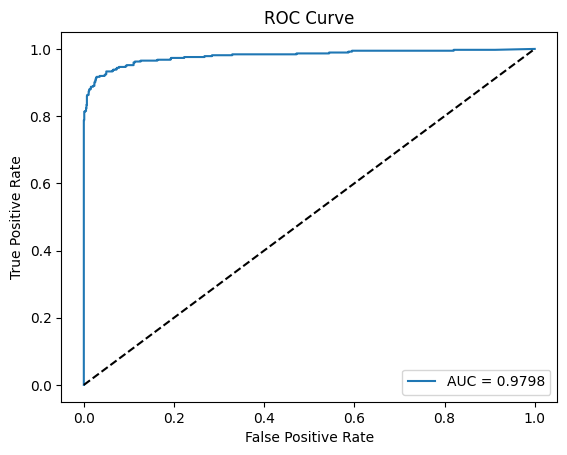

In [62]:
from sklearn.metrics import roc_auc_score, roc_curve
# Predict probabilities
y_probs = best_model.predict_proba(X_test)[:, 1]

# Calculate AUC-ROC
roc_auc = roc_auc_score(y_test, y_probs)
print(f"AUC-ROC: {roc_auc:.4f}")

# Plot ROC curve
fpr, tpr, thresholds = roc_curve(y_test, y_probs)
plt.plot(fpr, tpr, label=f"AUC = {roc_auc:.4f}")
plt.plot([0, 1], [0, 1], 'k--')  # Diagonal line for reference
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc="lower right")
plt.show()

###### Voting Classifier (Ensemble Model)
it is a technique to make a combinations between models to get higher accuracy
so here we will do a combinations of randomforestclassifier and kneighbors classifier and LogisticRegression

In [63]:
from sklearn.ensemble import VotingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, classification_report
import mlflow
import mlflow.sklearn

# Set the tracking URI for your Azure ML workspace
mlflow.set_tracking_uri("azureml://southafricanorth.api.azureml.ms/mlflow/v1.0/subscriptions/0146ae78-9468-4285-8cab-97231deb201d/resourceGroups/Final_Project/providers/Microsoft.MachineLearningServices/workspaces/CustomerChurnPrediction")

# Set the experiment name
mlflow.set_experiment("Voting Classifier")

# Initialize the individual classifiers
log_clf = LogisticRegression(random_state=42)
rf_clf = RandomForestClassifier(random_state=42)
knn_clf = KNeighborsClassifier()

# Create a VotingClassifier
voting_clf = VotingClassifier(
    estimators=[('lr', log_clf), ('rf', rf_clf), ('knn', knn_clf)],
    voting='hard'  # or use 'soft' for probability-based voting
)

# Start an MLflow run
with mlflow.start_run(run_name="VotingClassifier_Experiment") as run:
    
    # Train the Voting Classifier
    voting_clf.fit(X_train, y_train)
    
    # Predict on the test set
    y_pred_voting = voting_clf.predict(X_test)
    
    # Evaluate the Voting Classifier
    accuracy_voting = accuracy_score(y_test, y_pred_voting)
    clf_report = classification_report(y_test, y_pred_voting, output_dict=True)
    
    # Log model parameters
    mlflow.log_param("voting", "hard")
    mlflow.log_param("classifiers", ["Logistic Regression", "Random Forest", "KNN"])
    
    # Log evaluation metrics
    mlflow.log_metric("accuracy", accuracy_voting)
    mlflow.log_metric("precision_weighted", clf_report['weighted avg']['precision'])
    mlflow.log_metric("recall_weighted", clf_report['weighted avg']['recall'])
    mlflow.log_metric("f1_score_weighted", clf_report['weighted avg']['f1-score'])
    
    # Log the Voting Classifier model
    mlflow.sklearn.log_model(voting_clf, "VotingClassifierModel")
    
    # Get the run ID to register the model
    run_id = run.info.run_id
    print(f"Run ID: {run_id}")

    # Now, register the model using the run ID
    model_uri = f"runs:/{run_id}/VotingClassifierModel"
    
    # Register the model in Azure ML for deployment
    registered_model = mlflow.register_model(model_uri, "customer_churn_voting_classifier")

    print(f"Model registered: {registered_model.name}, version: {registered_model.version}")


2024/10/24 17:33:34 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.
Successfully registered model 'customer_churn_voting_classifier'.
2024/10/24 17:33:36 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: customer_churn_voting_classifier, version 1
Created version '1' of model 'customer_churn_voting_classifier'.
2024/10/24 17:33:36 INFO mlflow.tracking._tracking_service.client: 🏃 View run VotingClassifier_Experiment at: https://southafricanorth.api.azureml.ms/mlflow/v2.0/subscriptions/0146ae78-9468-4285-8cab-97231deb201d/resourceGroups/Final_Project/providers/Microsoft.MachineLearningServices/workspaces/CustomerChurnPrediction/#/experiments/27cc9712-a5ee-48fa-8099-70410bef6285/runs/abc8bdcc-8276-43ff-8de5-61578fd2547c.
2024/10/24 17:33:36 INFO mlflow.tracking._tracking_service.client: 🧪 

Run ID: abc8bdcc-8276-43ff-8de5-61578fd2547c
Model registered: customer_churn_voting_classifier, version: 1


In [64]:
print(f'Voting Classifier Accuracy: {accuracy_voting:.4f}')
print("Classification Report:\n", classification_report(y_test, y_pred_voting))

Voting Classifier Accuracy: 0.9585
Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.99      0.97      1024
           1       0.97      0.87      0.92       373

    accuracy                           0.96      1397
   macro avg       0.96      0.93      0.95      1397
weighted avg       0.96      0.96      0.96      1397



we got a better Results but not that much too but better than the optimization of random-forest model we got 95.85%

In [65]:
from sklearn.metrics import confusion_matrix
import plotly.figure_factory as ff

# Generate the confusion matrix
conf_matrix =  confusion_matrix(y_test, y_pred_voting)

# Plot the confusion matrix
z = conf_matrix
x = ['Not Churn', 'Churn']
y = ['Not Churn', 'Churn']

# Create a heatmap for the confusion matrix
fig = ff.create_annotated_heatmap(z, x=x, y=y, colorscale='Blues')

# Add title and labels
fig.update_layout(
    title="Confusion Matrix",
    xaxis_title="Predicted",
    yaxis_title="True"
)

fig.show()

### Model Deployment

##### Create an Inference Environment
create an environment that specifies the dependencies required for the model deployment. This includes libraries like scikit-learn, pandas, or others that the model needs to run.

In [103]:
from azureml.core.environment import Environment
from azureml.core.conda_dependencies import CondaDependencies

# Create an environment
env = Environment("churn-env")
cd = CondaDependencies.create(
        conda_packages=[
        "scikit-learn==0.24.2", 
        "numpy==1.19.2",
        "pandas==1.2.4"
        ],
    pip_packages=["scikit-learn", "pandas", "azureml-defaults", "flask", "numpy", "joblib", "plotly", "matplotlib", "seaborn", "statsmodels", "imblearn"]
)

env.python.conda_dependencies = cd
env.register(workspace=ws)  # Register the environment

print("Environment registered.")


Environment registered.


##### Create an Inference Configuration
An inference configuration tells Azure how to run the model once deployed. It specifies the environment and a scoring script.

Scoring Script: This script handles HTTP requests, loads the model, and returns predictions.

In [104]:
from azureml.core.environment import Environment
from azureml.core.model import InferenceConfig
from azureml.core.model import Model

env = Environment.get(workspace=ws, name="churn-env")  # Ensure correct environment
# Load your model
model = Model(workspace=ws, name="customer_churn_voting_classifier")

inference_config = InferenceConfig(
    entry_script="score.py",  # Ensure the script name is correct
    environment=env
)


##### ACI Deployment

In [105]:
from azureml.core.model import Model
from azureml.core.webservice import AciWebservice, Webservice

# Load the registered model from the Azure ML workspace
model = Model(workspace=ws, name="customer_churn_voting_classifier")  # Ensure this is the correct registered model name

# Define deployment configuration
aci_config = AciWebservice.deploy_configuration(
    cpu_cores=2, memory_gb=4
)

# Deploy the model
service = Model.deploy(
    workspace=ws,                    # Your Azure ML workspace
    name="customer-churn-service",    # Name of the service
    models=[model],                   # List of models to deploy
    inference_config=inference_config, 
    deployment_config=aci_config      # ACI configuration
)

# Wait for deployment to complete
service.wait_for_deployment(show_output=True)
print(service.state)


Tips: You can try get_logs(): https://aka.ms/debugimage#dockerlog or local deployment: https://aka.ms/debugimage#debug-locally to debug if deployment takes longer than 10 minutes.
Running
2024-10-24 19:59:07+00:00 Creating Container Registry if not exists.
2024-10-24 19:59:10+00:00 Building image..
2024-10-24 20:10:57+00:00 Generating deployment configuration..
2024-10-24 20:11:07+00:00 Submitting deployment to compute..
2024-10-24 20:11:20+00:00 Checking the status of deployment customer-churn-service..
2024-10-24 20:12:48+00:00 Checking the status of inference endpoint customer-churn-service.
Failed


Service deployment polling reached non-successful terminal state, current service state: Failed
Operation ID: f310bd54-6ec3-418e-8351-9274d9a36236
More information can be found using '.get_logs()'
Error:
{
  "code": "AciDeploymentFailed",
  "statusCode": 400,
  "message": "Aci Deployment failed with exception: Your container application crashed. This may be caused by errors in your scoring file's init() function.
	1. Please check the logs for your container instance: customer-churn-service. From the AML SDK, you can run print(service.get_logs()) if you have service object to fetch the logs.
	2. You can interactively debug your scoring file locally. Please refer to https://docs.microsoft.com/azure/machine-learning/how-to-debug-visual-studio-code#debug-and-troubleshoot-deployments for more information.
	3. You can also try to run image 5bfe0b59027641e097f3c7794150cfb4.azurecr.io/azureml/azureml_deb8cf6cc9c1a2715a3be39c8c9153ca locally. Please refer to https://aka.ms/debugimage#service-la

WebserviceException: WebserviceException:
	Message: Service deployment polling reached non-successful terminal state, current service state: Failed
Operation ID: f310bd54-6ec3-418e-8351-9274d9a36236
More information can be found using '.get_logs()'
Error:
{
  "code": "AciDeploymentFailed",
  "statusCode": 400,
  "message": "Aci Deployment failed with exception: Your container application crashed. This may be caused by errors in your scoring file's init() function.
	1. Please check the logs for your container instance: customer-churn-service. From the AML SDK, you can run print(service.get_logs()) if you have service object to fetch the logs.
	2. You can interactively debug your scoring file locally. Please refer to https://docs.microsoft.com/azure/machine-learning/how-to-debug-visual-studio-code#debug-and-troubleshoot-deployments for more information.
	3. You can also try to run image 5bfe0b59027641e097f3c7794150cfb4.azurecr.io/azureml/azureml_deb8cf6cc9c1a2715a3be39c8c9153ca locally. Please refer to https://aka.ms/debugimage#service-launch-fails for more information.",
  "details": [
    {
      "code": "CrashLoopBackOff",
      "message": "Your container application crashed. This may be caused by errors in your scoring file's init() function.
	1. Please check the logs for your container instance: customer-churn-service. From the AML SDK, you can run print(service.get_logs()) if you have service object to fetch the logs.
	2. You can interactively debug your scoring file locally. Please refer to https://docs.microsoft.com/azure/machine-learning/how-to-debug-visual-studio-code#debug-and-troubleshoot-deployments for more information.
	3. You can also try to run image 5bfe0b59027641e097f3c7794150cfb4.azurecr.io/azureml/azureml_deb8cf6cc9c1a2715a3be39c8c9153ca locally. Please refer to https://aka.ms/debugimage#service-launch-fails for more information."
    },
    {
      "code": "AciDeploymentFailed",
      "message": "Your container application crashed. Please follow the steps to debug:
	1. From the AML SDK, you can run print(service.get_logs()) if you have service object to fetch the logs. Please refer to https://aka.ms/debugimage#dockerlog for more information.
	2. If your container application crashed. This may be caused by errors in your scoring file's init() function. You can try debugging locally first. Please refer to https://aka.ms/debugimage#debug-locally for more information.
	3. You can also interactively debug your scoring file locally. Please refer to https://docs.microsoft.com/azure/machine-learning/how-to-debug-visual-studio-code#debug-and-troubleshoot-deployments for more information.
	4. View the diagnostic events to check status of container, it may help you to debug the issue.
"RestartCount": 3
"CurrentState": {"state":"Waiting","startTime":null,"exitCode":null,"finishTime":null,"detailStatus":"CrashLoopBackOff: Back-off restarting failed"}
"PreviousState": {"state":"Terminated","startTime":"2024-10-24T20:14:26.063Z","exitCode":111,"finishTime":"2024-10-24T20:14:39.282Z","detailStatus":"Error"}
"Events":
{"count":1,"firstTimestamp":"2024-10-24T20:11:26Z","lastTimestamp":"2024-10-24T20:11:26Z","name":"Pulling","message":"pulling image "5bfe0b59027641e097f3c7794150cfb4.azurecr.io/azureml/azureml_deb8cf6cc9c1a2715a3be39c8c9153ca@sha256:4cfe0a35666f6282a604d7514805cbc4c339e8a3f8011833c1847c66e7d3f93a"","type":"Normal"}
{"count":1,"firstTimestamp":"2024-10-24T20:12:09Z","lastTimestamp":"2024-10-24T20:12:09Z","name":"Pulled","message":"Successfully pulled image "5bfe0b59027641e097f3c7794150cfb4.azurecr.io/azureml/azureml_deb8cf6cc9c1a2715a3be39c8c9153ca@sha256:4cfe0a35666f6282a604d7514805cbc4c339e8a3f8011833c1847c66e7d3f93a"","type":"Normal"}
{"count":4,"firstTimestamp":"2024-10-24T20:12:31Z","lastTimestamp":"2024-10-24T20:14:26Z","name":"Started","message":"Started container","type":"Normal"}
{"count":4,"firstTimestamp":"2024-10-24T20:12:44Z","lastTimestamp":"2024-10-24T20:14:39Z","name":"Killing","message":"Container customer-churn-service terminated with ExitCode 111.","type":"Normal"}
"
    }
  ]
}
	InnerException None
	ErrorResponse 
{
    "error": {
        "message": "Service deployment polling reached non-successful terminal state, current service state: Failed\nOperation ID: f310bd54-6ec3-418e-8351-9274d9a36236\nMore information can be found using '.get_logs()'\nError:\n{\n  \"code\": \"AciDeploymentFailed\",\n  \"statusCode\": 400,\n  \"message\": \"Aci Deployment failed with exception: Your container application crashed. This may be caused by errors in your scoring file's init() function.\n\t1. Please check the logs for your container instance: customer-churn-service. From the AML SDK, you can run print(service.get_logs()) if you have service object to fetch the logs.\n\t2. You can interactively debug your scoring file locally. Please refer to https://docs.microsoft.com/azure/machine-learning/how-to-debug-visual-studio-code#debug-and-troubleshoot-deployments for more information.\n\t3. You can also try to run image 5bfe0b59027641e097f3c7794150cfb4.azurecr.io/azureml/azureml_deb8cf6cc9c1a2715a3be39c8c9153ca locally. Please refer to https://aka.ms/debugimage#service-launch-fails for more information.\",\n  \"details\": [\n    {\n      \"code\": \"CrashLoopBackOff\",\n      \"message\": \"Your container application crashed. This may be caused by errors in your scoring file's init() function.\n\t1. Please check the logs for your container instance: customer-churn-service. From the AML SDK, you can run print(service.get_logs()) if you have service object to fetch the logs.\n\t2. You can interactively debug your scoring file locally. Please refer to https://docs.microsoft.com/azure/machine-learning/how-to-debug-visual-studio-code#debug-and-troubleshoot-deployments for more information.\n\t3. You can also try to run image 5bfe0b59027641e097f3c7794150cfb4.azurecr.io/azureml/azureml_deb8cf6cc9c1a2715a3be39c8c9153ca locally. Please refer to https://aka.ms/debugimage#service-launch-fails for more information.\"\n    },\n    {\n      \"code\": \"AciDeploymentFailed\",\n      \"message\": \"Your container application crashed. Please follow the steps to debug:\n\t1. From the AML SDK, you can run print(service.get_logs()) if you have service object to fetch the logs. Please refer to https://aka.ms/debugimage#dockerlog for more information.\n\t2. If your container application crashed. This may be caused by errors in your scoring file's init() function. You can try debugging locally first. Please refer to https://aka.ms/debugimage#debug-locally for more information.\n\t3. You can also interactively debug your scoring file locally. Please refer to https://docs.microsoft.com/azure/machine-learning/how-to-debug-visual-studio-code#debug-and-troubleshoot-deployments for more information.\n\t4. View the diagnostic events to check status of container, it may help you to debug the issue.\n\"RestartCount\": 3\n\"CurrentState\": {\"state\":\"Waiting\",\"startTime\":null,\"exitCode\":null,\"finishTime\":null,\"detailStatus\":\"CrashLoopBackOff: Back-off restarting failed\"}\n\"PreviousState\": {\"state\":\"Terminated\",\"startTime\":\"2024-10-24T20:14:26.063Z\",\"exitCode\":111,\"finishTime\":\"2024-10-24T20:14:39.282Z\",\"detailStatus\":\"Error\"}\n\"Events\":\n{\"count\":1,\"firstTimestamp\":\"2024-10-24T20:11:26Z\",\"lastTimestamp\":\"2024-10-24T20:11:26Z\",\"name\":\"Pulling\",\"message\":\"pulling image \"5bfe0b59027641e097f3c7794150cfb4.azurecr.io/azureml/azureml_deb8cf6cc9c1a2715a3be39c8c9153ca@sha256:4cfe0a35666f6282a604d7514805cbc4c339e8a3f8011833c1847c66e7d3f93a\"\",\"type\":\"Normal\"}\n{\"count\":1,\"firstTimestamp\":\"2024-10-24T20:12:09Z\",\"lastTimestamp\":\"2024-10-24T20:12:09Z\",\"name\":\"Pulled\",\"message\":\"Successfully pulled image \"5bfe0b59027641e097f3c7794150cfb4.azurecr.io/azureml/azureml_deb8cf6cc9c1a2715a3be39c8c9153ca@sha256:4cfe0a35666f6282a604d7514805cbc4c339e8a3f8011833c1847c66e7d3f93a\"\",\"type\":\"Normal\"}\n{\"count\":4,\"firstTimestamp\":\"2024-10-24T20:12:31Z\",\"lastTimestamp\":\"2024-10-24T20:14:26Z\",\"name\":\"Started\",\"message\":\"Started container\",\"type\":\"Normal\"}\n{\"count\":4,\"firstTimestamp\":\"2024-10-24T20:12:44Z\",\"lastTimestamp\":\"2024-10-24T20:14:39Z\",\"name\":\"Killing\",\"message\":\"Container customer-churn-service terminated with ExitCode 111.\",\"type\":\"Normal\"}\n\"\n    }\n  ]\n}"
    }
}

In [79]:
print(service.get_logs())

None


In [98]:
# Get the existing service
existing_service = Webservice(workspace=ws, name="customer-churn-service")

# Delete the service
existing_service.delete()


Running
2024-10-24 19:14:10+00:00 Check and wait for operation (0c004e0b-49fa-4c3a-b5de-05ae7714b186) to finish..
2024-10-24 19:14:14+00:00 Deleting service entity.
Succeeded


##### Test the Deployed Model
After deployment, we test the model by sending a request to the endpoint.

In [ ]:
import json
import requests

# Replace with your service's scoring URI and API key
scoring_uri = service.scoring_uri
headers = {'Content-Type': 'application/json'}

# Sample data for prediction
data = json.dumps({
    'data': [[42, 6000, 0, 1], [34, 4500, 1, 0]]  # Example features
})

# Make a POST request
response = requests.post(scoring_uri, data=data, headers=headers)
print("Predictions:", response.json())


##### Monitor the Deployment
we monitor the deployed service using Azure ML Studio

In [ ]:
print(service.state)  # Check the status
print(service.scoring_uri)  # Get the URI to make requests
print(service.logs())  # Check logs for debugging